# Librerías

In [2]:
import os
import matplotlib.pyplot as plt
import numpy as np
import gc
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torch.optim import Adam
from torchvision import transforms
from torchsummary import summary
from tqdm import tqdm
from PIL import Image
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Dataset

In [3]:


class MyDataset_tv(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.samples = []
                
        for file_name in os.listdir(image_dir):
            if file_name.endswith('.jpg'):
                image_path = os.path.join(image_dir, file_name)
                # mask is in png format
                file_name = file_name.replace('.jpg', '.png')
                mask_path = os.path.join(mask_dir, file_name)
                sample = (image_path, mask_path)
                self.samples.append(sample)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        image_path, mask_path = self.samples[idx]
        image = Image.open(image_path).convert("RGB")
        mask = Image.open(mask_path).convert("RGB")

        # image = np.array(image)
        # mask = np.array(mask)

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask
    

In [4]:
class MyDataset_al(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.samples = []
                
        for file_name in os.listdir(image_dir):
            if file_name.endswith('.jpg'):
                image_path = os.path.join(image_dir, file_name)
                # mask is in png format
                file_name = file_name.replace('.jpg', '.png')
                mask_path = os.path.join(mask_dir, file_name)
                sample = (image_path, mask_path)
                self.samples.append(sample)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        image_path, mask_path = self.samples[idx]
        image = Image.open(image_path).convert("RGB")
        mask = Image.open(mask_path)

        image = np.array(image)
        mask = np.array(mask).astype(np.float32)

        if self.transform:
            aug = self.transform(image=image, mask=mask)
            image = aug['image']
            mask = aug['mask']

        return image, mask

In [5]:
def get_images(transform = None,batch_size=8,shuffle=True,pin_memory=True):

    train_dataset = MyDataset(image_dir='train/images', mask_dir=f'train/{mask_dir_string}', transform=transform)
    train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4) #nm = 4 para linux

    test_dataset = MyDataset(image_dir='test/images', mask_dir=f'test/{mask_dir_string}', transform=transform)
    test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=4) #nm = 4 para linux

    train_batch = DataLoader(train_dataset, batch_size=batch_size, shuffle=shuffle, num_workers=4)
    test_batch = DataLoader(test_dataset, batch_size=batch_size, shuffle=shuffle, num_workers=4)
    
    return train_batch,test_batch

## Transforms

In [6]:
from torchvision import transforms
import torch
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Torchvision
tv_t = transforms.Compose([
    transforms.Resize((256, 256)), # modificar a 512
    
    transforms.ToTensor(),
])
tv_t_norm = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
])

# Albumentations
al_t = A.Compose([
    A.Resize(256,256),
    ToTensorV2()
])
al_t_norm = A.Compose([
    A.Resize(256,256),
    A.augmentations.transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ToTensorV2()
])

In [7]:
t_sel = al_t_norm # tv_t, tv_t_norm, al_t, al_t_norm
MyDataset = MyDataset_al # MyDataset_tv, MyDataset_al
mask_dir_string = 'masksSC' # 'masksSC', 'masksRGB', 'masksNPY', 'masksONE'

train_batch,test_batch = get_images(transform=t_sel, batch_size=8)

In [8]:
len(train_batch),len(test_batch)

(447, 50)

In [9]:
class_dict = {
    0: 'background',
    1: 'opinión',
    2: 'política',
    3: 'portada',
    4: 'economía',
    5: 'sociedad',
    6: 'en portada',
    7: 'deportes',
    8: 'mundo',
    9: 'ocio y cultura',
    10: 'otros'
}

In [10]:
rgb_dict = {
    0: [0, 0, 0],
    1: [0, 0, 255],
    2: [0, 255, 0],
    3: [0, 255, 255],
    4: [255, 0, 0],
    5: [255, 0, 255],
    6: [255, 255, 0],
    7: [255, 255, 255],
    8: [128, 128, 128],
    9: [128, 128, 0],
    10: [128, 0, 128],
}

In [11]:
def convert_np_to_mask(np_mask):
    mask = np.zeros((np_mask.shape[0], np_mask.shape[1], 3), dtype=np.uint8)
    for i in range(11):
        mask[np_mask == i] = rgb_dict[i]
    return mask

In [12]:
def get_mask_unique_values(mask):

    if mask.shape == (256,256,3):
        value_counts = np.unique(mask.reshape(-1,3), axis=0, return_counts=True)
    elif mask.shape == (256,256):
        value_counts = np.unique(mask, return_counts=True)

    value_counts = (value_counts[0], 100*value_counts[1]/np.sum(value_counts[1]))

    # convert value_counts to int
    value_counts = (value_counts[0].astype(int), value_counts[1].astype(int))

    #print(f"\nClasses present in the mask: ")
    for i in range(len(value_counts[0])):
        print(f" -{class_dict[value_counts[0][i]]}: {value_counts[1][i]}%")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([8, 256, 256])

IMAGE 1
 -background: 3%
 -portada: 96%

IMAGE 2
 -background: 8%
 -ocio y cultura: 91%

IMAGE 3
 -background: 15%
 -opinión: 84%


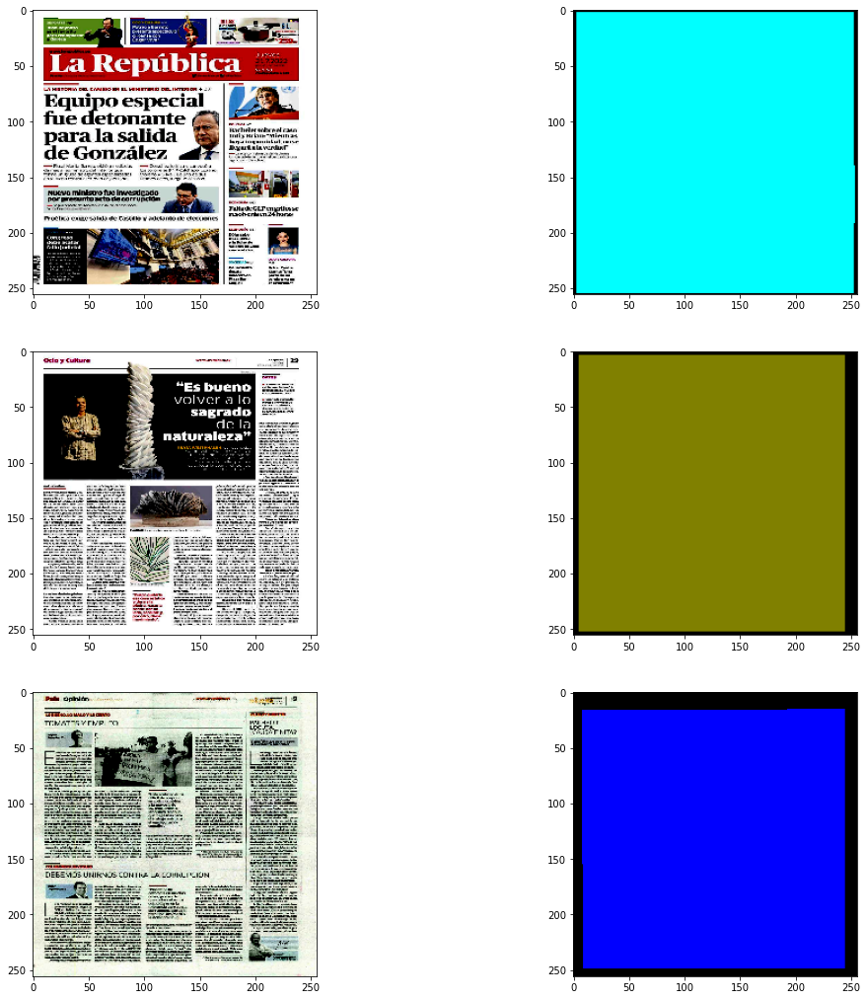

In [13]:
for img,mask in train_batch:

    print(mask.shape)

    img1 = np.transpose(img[0,:,:,:],(1,2,0))
    mask1 = convert_np_to_mask(np.array(mask[0,:,:]))
    img2 = np.transpose(img[1,:,:,:],(1,2,0))
    mask2 = convert_np_to_mask(np.array(mask[1,:,:]))
    img3 = np.transpose(img[2,:,:,:],(1,2,0))
    mask3 = convert_np_to_mask(np.array(mask[2,:,:]))
    fig , ax =  plt.subplots(3, 2, figsize=(18, 18))
    ax[0][0].imshow(img1)
    ax[0][1].imshow(mask1)
    ax[1][0].imshow(img2)
    ax[1][1].imshow(mask2)
    ax[2][0].imshow(img3)
    ax[2][1].imshow(mask3)

    print(f"\nIMAGE 1")
    get_mask_unique_values(mask[0,:,:])
    print(f"\nIMAGE 2")
    get_mask_unique_values(mask[1,:,:])
    print(f"\nIMAGE 3")
    get_mask_unique_values(mask[2,:,:])


    break

# Arquitectura

In [14]:
class encoding_block(nn.Module):
    def __init__(self,in_channels, out_channels):
        super(encoding_block,self).__init__()
        model = []
        model.append(nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False))
        model.append(nn.BatchNorm2d(out_channels))
        model.append(nn.ReLU(inplace=True))
        model.append(nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False))
        model.append(nn.BatchNorm2d(out_channels))
        model.append(nn.ReLU(inplace=True))
        self.conv = nn.Sequential(*model)
    def forward(self, x):
        return self.conv(x)  

class unet_model(nn.Module):
    def __init__(self,out_channels=11, features=[64, 128, 256, 512]): # features=[64, 128, 256, 512]): 
        super(unet_model,self).__init__()
        self.pool = nn.MaxPool2d(kernel_size=(2,2),stride=(2,2))
        self.conv1 = encoding_block(3,features[0])
        self.conv2 = encoding_block(features[0],features[1])
        self.conv3 = encoding_block(features[1],features[2])
        self.conv4 = encoding_block(features[2],features[3])
        self.conv5 = encoding_block(features[3]*2,features[3])
        self.conv6 = encoding_block(features[3],features[2])
        self.conv7 = encoding_block(features[2],features[1])
        self.conv8 = encoding_block(features[1],features[0])        
        self.tconv1 = nn.ConvTranspose2d(features[-1]*2, features[-1], kernel_size=2, stride=2)
        self.tconv2 = nn.ConvTranspose2d(features[-1], features[-2], kernel_size=2, stride=2)
        self.tconv3 = nn.ConvTranspose2d(features[-2], features[-3], kernel_size=2, stride=2)
        self.tconv4 = nn.ConvTranspose2d(features[-3], features[-4], kernel_size=2, stride=2)        
        self.bottleneck = encoding_block(features[3],features[3]*2)
        self.final_layer = nn.Conv2d(features[0],out_channels,kernel_size=1)
    def forward(self,x):
        skip_connections = []
        x = self.conv1(x)
        skip_connections.append(x)
        x = self.pool(x)
        x = self.conv2(x)
        skip_connections.append(x)
        x = self.pool(x)
        x = self.conv3(x)
        skip_connections.append(x)
        x = self.pool(x)
        x = self.conv4(x)
        skip_connections.append(x)
        x = self.pool(x)
        x = self.bottleneck(x)
        skip_connections = skip_connections[::-1]
        x = self.tconv1(x)
        x = torch.cat((skip_connections[0], x), dim=1)
        x = self.conv5(x)
        x = self.tconv2(x)
        x = torch.cat((skip_connections[1], x), dim=1)
        x = self.conv6(x)
        x = self.tconv3(x)
        x = torch.cat((skip_connections[2], x), dim=1)
        x = self.conv7(x)        
        x = self.tconv4(x)
        x = torch.cat((skip_connections[3], x), dim=1)
        x = self.conv8(x)
        x = self.final_layer(x)
        return x

# Test

In [15]:
DEVICE = f'cuda:{0}' if torch.cuda.is_available() else 'cpu'
DEVICE

'cuda:0'

In [16]:
def clean_memory():
    gc.collect()
    torch.cuda.empty_cache()
    print("Total memory allocated by tensors on GPU:", torch.cuda.memory_allocated())
    print("Total memory reserved by CUDA on GPU:", torch.cuda.memory_reserved())
clean_memory()

Total memory allocated by tensors on GPU: 0
Total memory reserved by CUDA on GPU: 0


In [17]:
print(unet_model())

unet_model(
  (pool): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  (conv1): encoding_block(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (conv2): encoding_block(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine

In [18]:
model = unet_model().to(DEVICE)
summary(model, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,728
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,864
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
    encoding_block-7         [-1, 64, 256, 256]               0
         MaxPool2d-8         [-1, 64, 128, 128]               0
            Conv2d-9        [-1, 128, 128, 128]          73,728
      BatchNorm2d-10        [-1, 128, 128, 128]             256
             ReLU-11        [-1, 128, 128, 128]               0
           Conv2d-12        [-1, 128, 128, 128]         147,456
      BatchNorm2d-13        [-1, 128, 128, 128]             256
             ReLU-14        [-1, 128, 1

In [19]:
LEARNING_RATE = 1e-3
num_epochs = 20

In [20]:
loss_fn = nn.CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=LEARNING_RATE)
scaler = torch.cuda.amp.GradScaler()

## Entrenamiento

In [119]:
for epoch in range(num_epochs):
    loop = tqdm(enumerate(train_batch),total=len(train_batch))
    for batch_idx, (data, targets) in loop:

        data = data.to(DEVICE)
        targets = targets.to(DEVICE)
        targets = targets.type(torch.long)

        num_classes = 11
        targets = torch.clamp(targets, 0, num_classes - 1)

        # forward
        with torch.cuda.amp.autocast():
            predictions = model(data)
            loss = loss_fn(predictions, targets)
        # backward
        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        # update tqdm loop
        loop.set_postfix(loss=loss.item())

100%|██████████| 447/447 [00:29<00:00, 15.15it/s, loss=0.668]


In [120]:
# save model
torch.save(model.state_dict(), 'unet.pth')

In [21]:
# load model
model = unet_model().to(DEVICE)
model.load_state_dict(torch.load('unet.pth'))
model.eval()

unet_model(
  (pool): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  (conv1): encoding_block(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (conv2): encoding_block(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine

## Metricas

### Jaccard, Confusion Matrix ...

In [47]:
def improve_prediction(predictions):

    # predictions shape is torch.Size([8, 256, 256])(batch_size, height, width), loop over the batch
    for i in range(predictions.shape[0]):
        prediction = predictions[i].detach().cpu().numpy()

        if prediction.shape == (256,256,3):
            value_counts = np.unique(prediction.reshape(-1,3), axis=0, return_counts=True)
        elif prediction.shape == (256,256):
            value_counts = np.unique(prediction, return_counts=True)

        value_counts = (value_counts[0], 100*value_counts[1]/np.sum(value_counts[1]))

        high_count_index = np.argmax(value_counts[1])
        high_count_class = value_counts[0][high_count_index]
        high_count = value_counts[1][high_count_index]

        low_count_threshold = 20
        lowest_count_threshold = 5


        # remove all classes with less than 15% of the highest class
        for i in range(len(value_counts[0])):
            #print(f"      Evaluating: {class_dict[value_counts[0][i]]}: {value_counts[1][i]}%")
            if ((value_counts[1][i] < low_count_threshold and high_count > 50 ) or (value_counts[1][i] < lowest_count_threshold) ) and value_counts[0][i] != 0:
                prediction[prediction == value_counts[0][i]] = high_count_class
                # Print the replaced class
                #print(f"      {class_dict[value_counts[0][i]]} replaced by {class_dict[high_count_class]}")

        # print the unique values of the mask
        #print(f"\n    Unique values of the mask after improvement:")
        #get_mask_unique_values(prediction)



    return predictions

def improve_single_prediction(prediction):

    if prediction.shape == (256,256,3):
        value_counts = np.unique(prediction.reshape(-1,3), axis=0, return_counts=True)
    elif prediction.shape == (256,256):
        value_counts = np.unique(prediction, return_counts=True)

    value_counts = (value_counts[0], 100*value_counts[1]/np.sum(value_counts[1]))

    high_count_index = np.argmax(value_counts[1])
    high_count_class = value_counts[0][high_count_index]
    high_count = value_counts[1][high_count_index]

    low_count_threshold = 20
    lowest_count_threshold = 5

    for i in range(len(value_counts[0])):
            #print(f"      Evaluating: {class_dict[value_counts[0][i]]}: {value_counts[1][i]}%")
            if ((value_counts[1][i] < low_count_threshold and high_count > 50 ) or (value_counts[1][i] < lowest_count_threshold) ) and value_counts[0][i] != 0:
                prediction[prediction == value_counts[0][i]] = high_count_class
                # Print the replaced class
                #print(f"      {class_dict[value_counts[0][i]]} replaced by {class_dict[high_count_class]}")

    # print the unique values of the mask
    #print(f"\n    Unique values of the mask after improvement:")
    #get_mask_unique_values(prediction)

    return prediction

In [23]:
def check_accuracy_jaccard(loader, model):
    num_correct = 0
    num_pixels = 0
    jaccard = 0
    model.eval()
    with torch.no_grad():
        for x, y in loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE)
            y = y.type(torch.long)
            num_pixels += y.numel()
            num_classes = 11
            y = torch.clamp(y, 0, num_classes - 1)
            predictions = model(x)
            predictions = torch.argmax(predictions, dim=1)
            predictions = improve_prediction(predictions)
            num_correct += (predictions == y).sum()
            jaccard += (predictions == y).sum() / ((predictions == y).sum() + (predictions != y).sum())
    print(f"Got {num_correct}/{num_pixels} with accuracy {num_correct/num_pixels*100:.2f}")
    print(f"Jaccard: {jaccard/len(loader)}")
    model.train()

In [24]:
def check_accuracy(loader, model):
    num_correct = 0
    num_pixels = 0
    dice_score = 0
    model.eval()

    with torch.no_grad():
        for x, y in loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE)
            softmax = nn.Softmax(dim=1)
            preds = torch.argmax(softmax(model(x)),axis=1)
            num_correct += (preds == y).sum()
            num_pixels += torch.numel(preds)
            dice_score += (2 * (preds * y).sum()) / ((preds + y).sum() + 1e-8)

    print(f"Got {num_correct}/{num_pixels} with acc {num_correct/num_pixels*100:.2f}")
    print(f"Dice score: {dice_score/len(loader)}")
    model.train()

In [29]:
check_accuracy(train_batch, model)

Got 173585787/234160128 with acc 74.13
Dice score: 4.27372407913208


In [30]:
check_accuracy(test_batch, model)

Got 18614316/25952256 with acc 71.73
Dice score: 4.081336498260498


In [31]:
check_accuracy_jaccard(train_batch, model)

Got 173585790/234160128 with accuracy 74.13
Jaccard: 0.7414159178733826


In [32]:
check_accuracy_jaccard(test_batch, model)

Got 18614322/25952256 with accuracy 71.73
Jaccard: 0.7176674604415894


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([8, 256, 256])
IMAGE 1
Real
 -background: 13%
 -sociedad: 86%
Predicted
 -background: 13%
 -política: 35%
 -sociedad: 50%

IMAGE 2
Real
 -background: 15%
 -otros: 84%
Predicted
 -background: 16%
 -otros: 83%

IMAGE 3
Real
 -background: 14%
 -opinión: 85%
Predicted
 -background: 14%
 -opinión: 85%


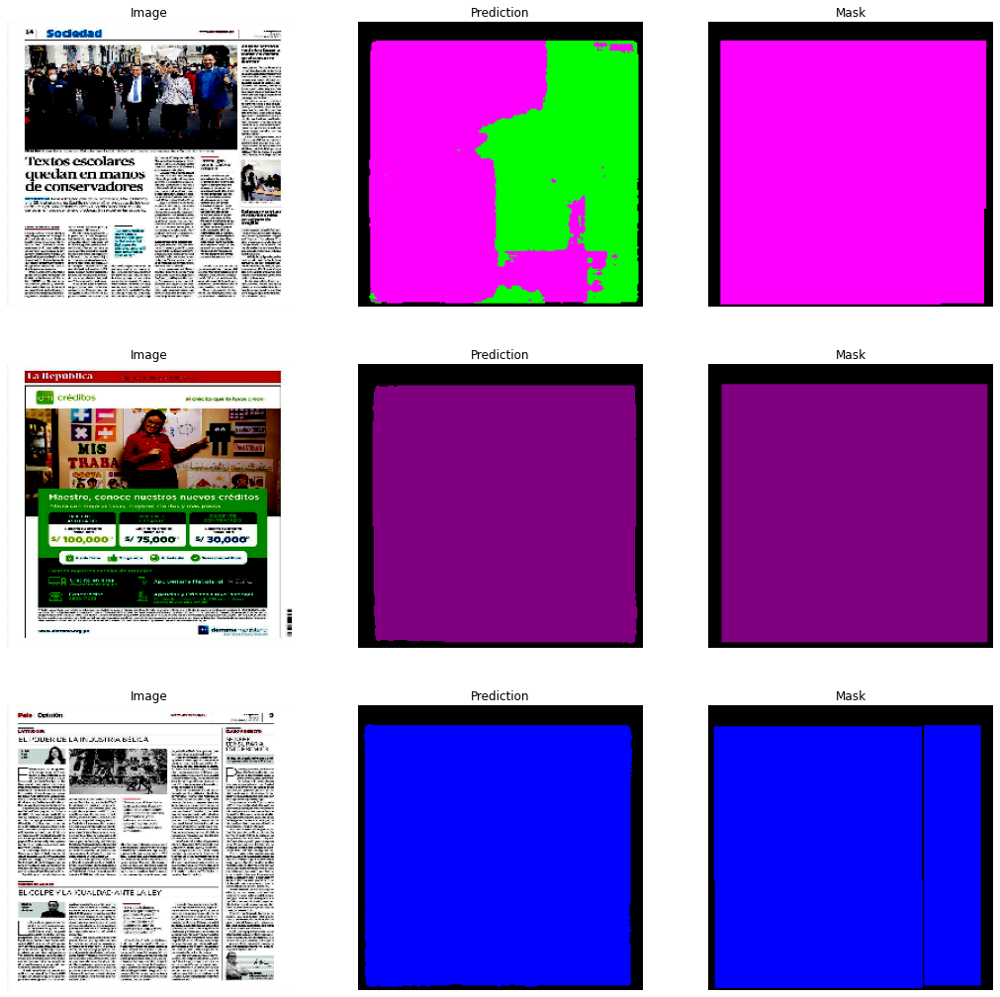

In [33]:
for x,y in test_batch:
    x = x.to(DEVICE)

    fig , ax =  plt.subplots(3, 3, figsize=(18, 18))
    softmax = nn.Softmax(dim=1)
    preds = torch.argmax(softmax(model(x)),axis=1).to('cpu')
    preds = improve_prediction(preds)

    print(preds.shape)

    img1 = np.transpose(np.array(x[0,:,:,:].to('cpu')),(1,2,0))
    preds1 = convert_np_to_mask(np.array(preds[0,:,:]))
    mask1 = convert_np_to_mask(np.array(y[0,:,:]))
    img2 = np.transpose(np.array(x[1,:,:,:].to('cpu')),(1,2,0))
    preds2 = convert_np_to_mask(np.array(preds[1,:,:]))
    mask2 = convert_np_to_mask(np.array(y[1,:,:]))
    img3 = np.transpose(np.array(x[2,:,:,:].to('cpu')),(1,2,0))
    preds3 = convert_np_to_mask(np.array(preds[2,:,:]))
    mask3 = convert_np_to_mask(np.array(y[2,:,:]))
    ax[0,0].set_title('Image')
    ax[0,1].set_title('Prediction')
    ax[0,2].set_title('Mask')
    ax[1,0].set_title('Image')
    ax[1,1].set_title('Prediction')
    ax[1,2].set_title('Mask')
    ax[2,0].set_title('Image')
    ax[2,1].set_title('Prediction')
    ax[2,2].set_title('Mask')
    ax[0][0].axis("off")
    ax[1][0].axis("off")
    ax[2][0].axis("off")
    ax[0][1].axis("off")
    ax[1][1].axis("off")
    ax[2][1].axis("off")
    ax[0][2].axis("off")
    ax[1][2].axis("off")
    ax[2][2].axis("off")
    ax[0][0].imshow(img1)
    ax[0][1].imshow(preds1)
    ax[0][2].imshow(mask1)
    ax[1][0].imshow(img2)
    ax[1][1].imshow(preds2)
    ax[1][2].imshow(mask2)
    ax[2][0].imshow(img3)
    ax[2][1].imshow(preds3)
    ax[2][2].imshow(mask3)

    print("IMAGE 1")
    print("Real")
    get_mask_unique_values(y[0,:,:])
    print("Predicted")
    get_mask_unique_values(np.array(preds[0,:,:]))

    print(f"\nIMAGE 2")
    print("Real")
    get_mask_unique_values(y[1,:,:])
    print("Predicted")
    get_mask_unique_values(np.array(preds[1,:,:]))

    print(f"\nIMAGE 3")
    print("Real")
    get_mask_unique_values(y[2,:,:])
    print("Predicted")
    get_mask_unique_values(np.array(preds[2,:,:]))


    break

In [25]:
# Do the general confusion matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns

def plot_confusion_matrix(loader, model):
    model.eval()
    confusion_matrix = torch.zeros(11, 11)
    with torch.no_grad():
        for x, y in loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE)
            y = y.type(torch.long)
            num_classes = 11
            y = torch.clamp(y, 0, num_classes - 1)
            predictions = model(x)
            predictions = torch.argmax(predictions, dim=1)
            predictions = improve_prediction(predictions)
            for t, p in zip(y.view(-1), predictions.view(-1)):
                confusion_matrix[t.long(), p.long()] += 1
    model.train()

    return confusion_matrix

confusion_matrix = plot_confusion_matrix(test_batch, model)


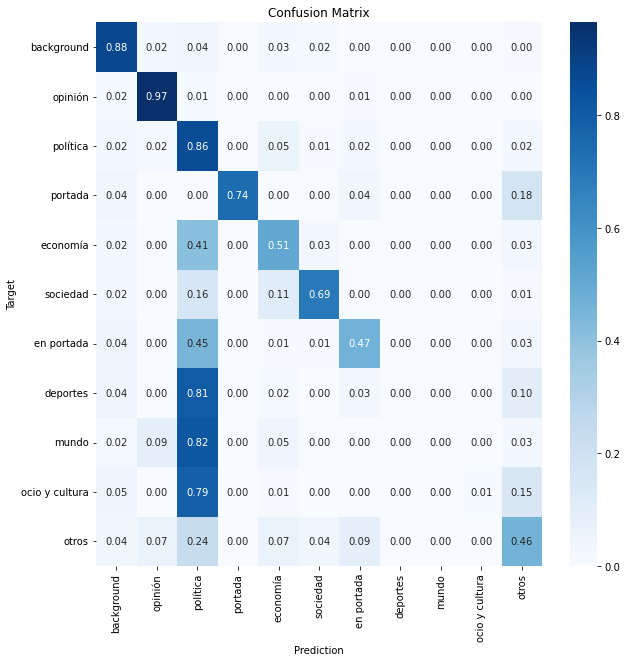

In [26]:
# convert the values of the confusion_maxtrix to percentage
confusion_matrix_p = confusion_matrix.numpy()
confusion_matrix_p = confusion_matrix_p / confusion_matrix_p.sum(axis=1)[:,None]

plt.figure(figsize=(10,10))
sns.heatmap(confusion_matrix_p, annot=True, fmt=".2f", cmap='Blues', xticklabels=class_dict.values(), yticklabels=class_dict.values())
plt.xlabel('Prediction')
plt.ylabel('Target')
plt.title('Confusion Matrix')
plt.show()

 -background: 16%
 -política: 83%


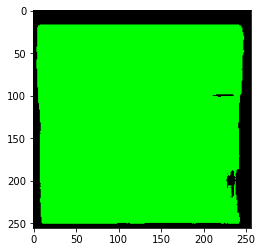

In [39]:
# test the model on test_image.jpg
from PIL import Image

def predict_image(image_path, model):
    image = Image.open(image_path)
    image = np.array(image)  # Convertir la imagen a numpy array
    image = t_sel(image=image)['image']  # Pasar la imagen como un argumento con nombre
    image = image.unsqueeze(0)
    image = image.to(DEVICE)
    model.eval()
    with torch.no_grad():
        predictions = model(image)
        predictions = torch.argmax(predictions, dim=1)
    return predictions

predictions = predict_image('test_image2.jpg', model)

predictions = predictions.squeeze(0).cpu().numpy()
predictions = improve_single_prediction(predictions)

mask = convert_np_to_mask(predictions)

get_mask_unique_values(predictions)

plt.imshow(mask)

# Prueba en carpetas de archivos

In [25]:
import os
import fnmatch

In [26]:
def find_files(directory, pattern):
    for root, dirs, files in os.walk(directory):
        for basename in files:
            if fnmatch.fnmatch(basename, pattern):
                filename = os.path.join(root, basename)
                yield filename

In [28]:
def predict_image(image_path, model):
    image = Image.open(image_path)
    image = np.array(image)  # Convertir la imagen a numpy array
    image = t_sel(image=image)['image']  # Pasar la imagen como un argumento con nombre
    image = image.unsqueeze(0)
    image = image.to(DEVICE)
    model.eval()
    with torch.no_grad():
        predictions = model(image)
        predictions = torch.argmax(predictions, dim=1)
    return predictions

# Testing

In [27]:
altura_px_show = 1040
ancho_px_show = 820

In [34]:
def predict_images_in_directory(directory, model=model, n=10):

    if not os.path.exists(directory):
        print(f"Directory '{directory}' not found")
        return

    images_found = len(list(find_files(directory, '*.jpg')))
    if images_found == 0:
        print(f"No images found in directory '{directory}'")
        return

    # print number of images found
    print(f"Found {images_found} images in directory '{directory}'")

    if images_found > n:
        print(f"Showing the first {n} images")

    for image_path in find_files(directory, '*.jpg'):
        predictions = predict_image(image_path, model)
        predictions = predictions.squeeze(0).cpu().numpy()
        predictions = improve_single_prediction(predictions)
        mask = convert_np_to_mask(predictions)
        get_mask_unique_values(predictions)

        fig, ax = plt.subplots(1, 2, figsize=(18, 18))
        resized_image = Image.open(image_path)
        resized_image = resized_image.resize((ancho_px_show, altura_px_show))
        resized_mask = Image.fromarray(mask)
        resized_mask = resized_mask.resize((ancho_px_show, altura_px_show))

        ax[0].imshow(resized_image)
        ax[1].imshow(resized_mask)
        plt.show()

        n -= 1
        if n == 0:
            break

In [84]:
def predict_images_in_directory_2(directory, model=model, n=10):

    if not os.path.exists(directory):
        print(f"Directory '{directory}' not found")
        return

    images_found = len(list(find_files(directory, '*.jpg')))
    if images_found == 0:
        print(f"No images found in directory '{directory}'")
        return

    # print number of images found
    print(f"Found {images_found} images in directory '{directory}'")

    if images_found > n:
        print(f"Showing the first {n} images")

    for image_path in find_files(directory, '*.jpg'):
        predictions = predict_image(image_path, model)
        predictions = predictions.squeeze(0).cpu().numpy()
        predictions = improve_single_prediction(predictions)
        mask = convert_np_to_mask(predictions)
        get_mask_unique_values(predictions)

        # path after the last '/' in image_path
        last_path = image_path.split('/')[-1].replace('.jpg', '.png')
        truth_path = 'test/masksRGB/' + last_path

        # find maskRGB



        fig, ax = plt.subplots(1, 3, figsize=(18, 18))
        resized_image = Image.open(image_path)
        resized_image = resized_image.resize((ancho_px_show, altura_px_show))
        resized_mask = Image.fromarray(mask)
        resized_mask = resized_mask.resize((ancho_px_show, altura_px_show))
        truth = Image.open(truth_path)
        resized_truth = truth.resize((ancho_px_show, altura_px_show))



        ax[0].imshow(resized_image)
        ax[1].imshow(resized_mask)
        ax[2].imshow(resized_truth)
        plt.show()

        n -= 1
        if n == 0:
            break


## Per category

In [79]:
class_dict = {
    0: 'background',
    1: 'opinión',
    2: 'política',
    3: 'portada',
    4: 'economía',
    5: 'sociedad',
    6: 'en portada',
    7: 'deportes',
    8: 'mundo',
    9: 'ocio y cultura',
    10: 'otros'
}

rgb_dict = {
    0: [0, 0, 0],
    1: [0, 0, 255],
    2: [0, 255, 0],
    3: [0, 255, 255],
    4: [255, 0, 0],
    5: [255, 0, 255],
    6: [255, 255, 0],
    7: [255, 255, 255],
    8: [128, 128, 128],
    9: [128, 128, 0],
    10: [128, 0, 128],
}

- 0: 'background',
- 1: 'opinión',
- 2: 'política',
- 3: 'portada',
- 4: 'economía',
- 5: 'sociedad',
- 6: 'en portada',
- 7: 'deportes',
- 8: 'mundo',
- 9: 'ocio y cultura',
- 10: 'otros'

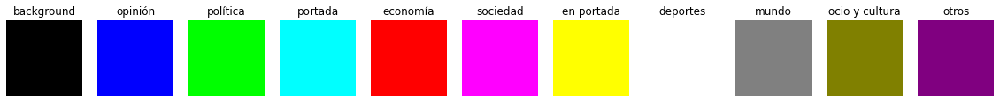

In [81]:
fig, ax = plt.subplots(1, 11, figsize=(20, 20))
for i in range(11):
    ax[i].imshow(np.array([[rgb_dict[i]]]))
    ax[i].axis('off')
    ax[i].set_title(class_dict[i])

### 1: 'opinión'

Found 10 images in directory 'classes/1'
 -background: 13%
 -opinión: 86%


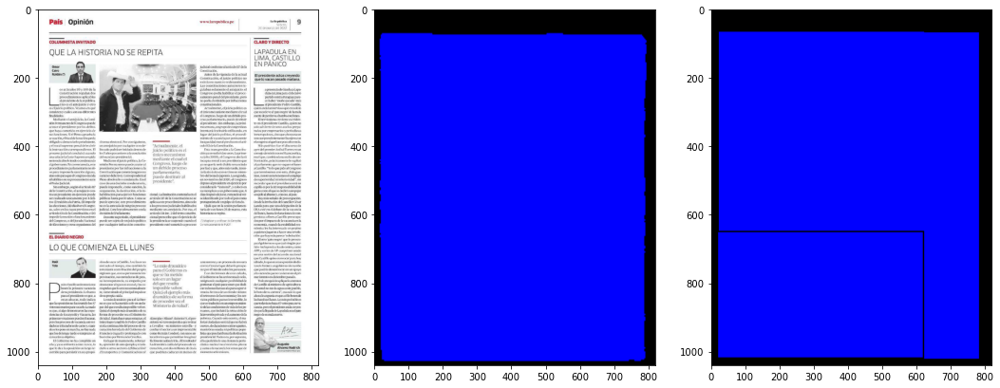

 -background: 21%
 -opinión: 78%


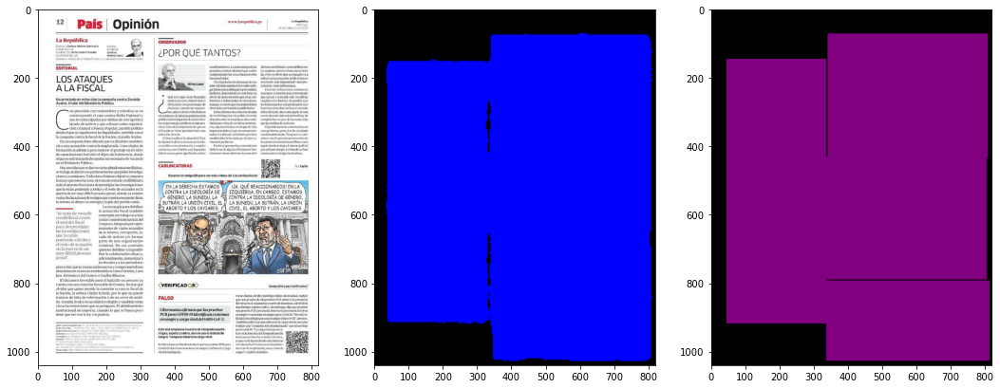

 -background: 13%
 -opinión: 86%


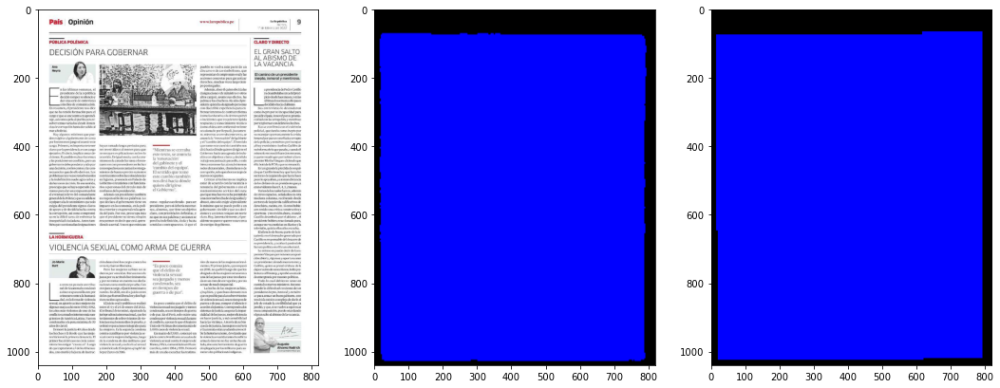

 -background: 13%
 -opinión: 86%


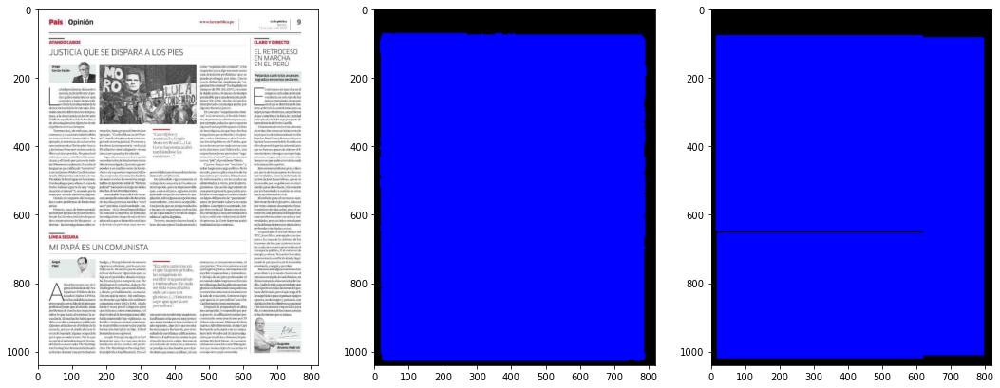

 -background: 21%
 -opinión: 78%


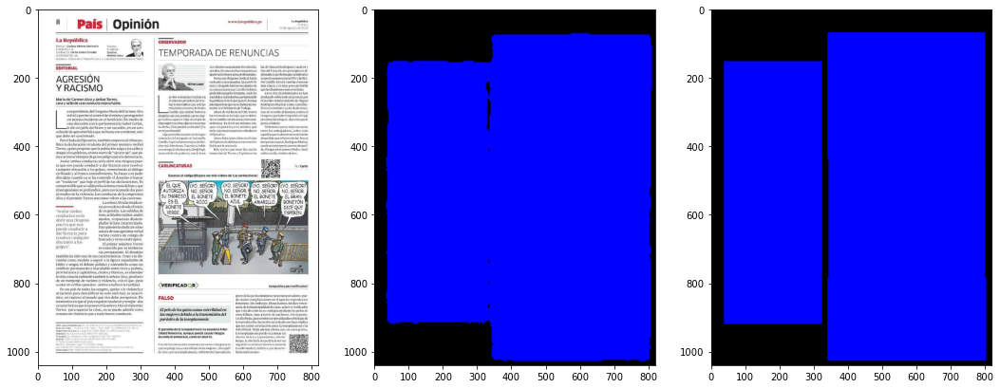

 -background: 13%
 -opinión: 86%


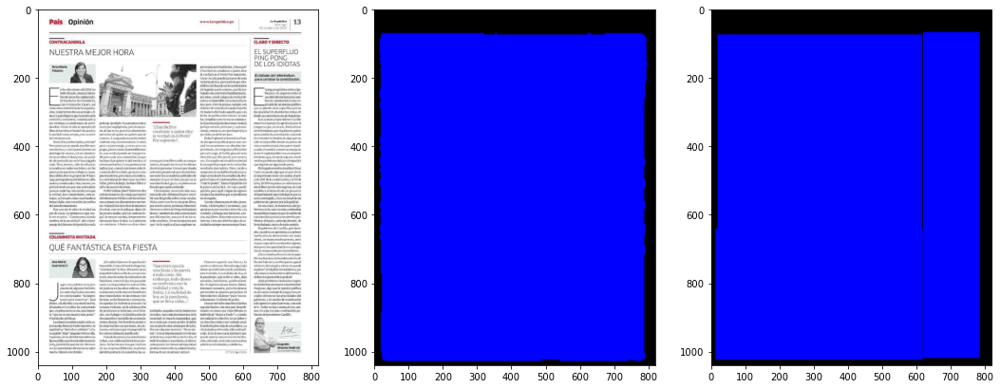

 -background: 13%
 -opinión: 86%


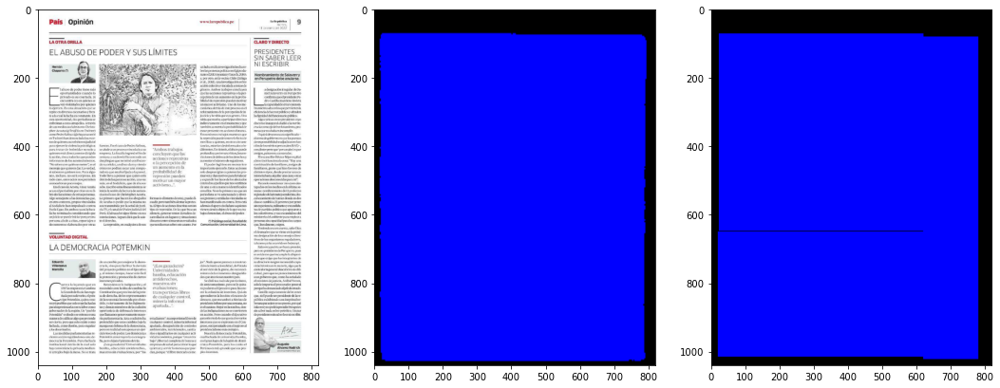

 -background: 13%
 -opinión: 86%


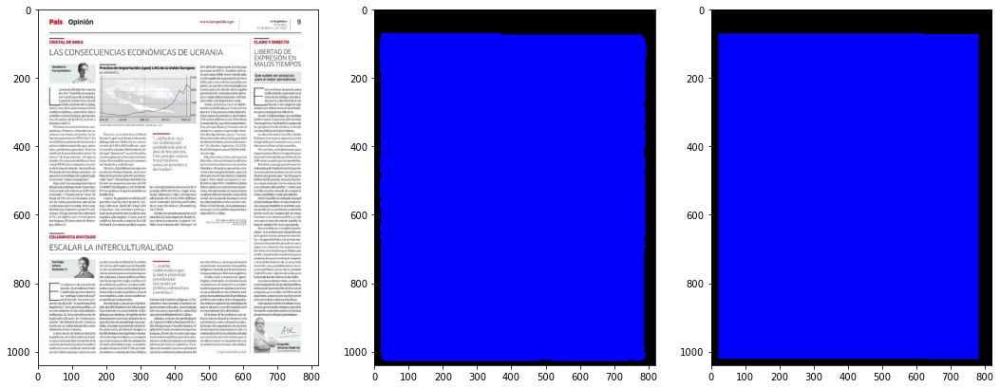

 -background: 13%
 -opinión: 86%


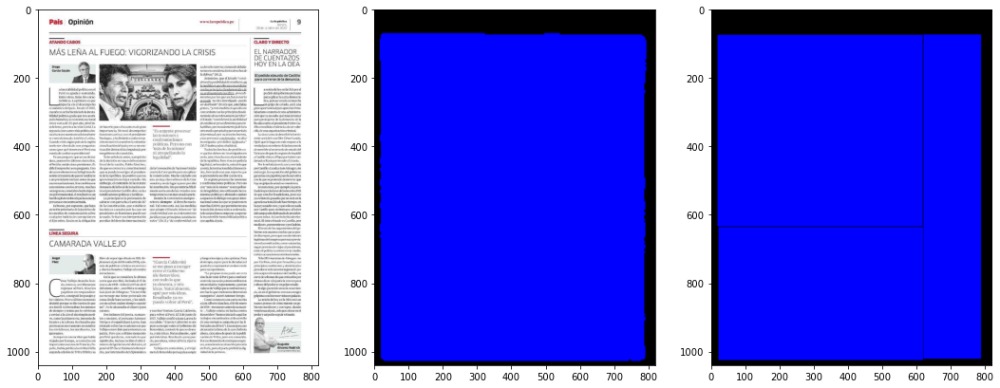

 -background: 27%
 -opinión: 72%


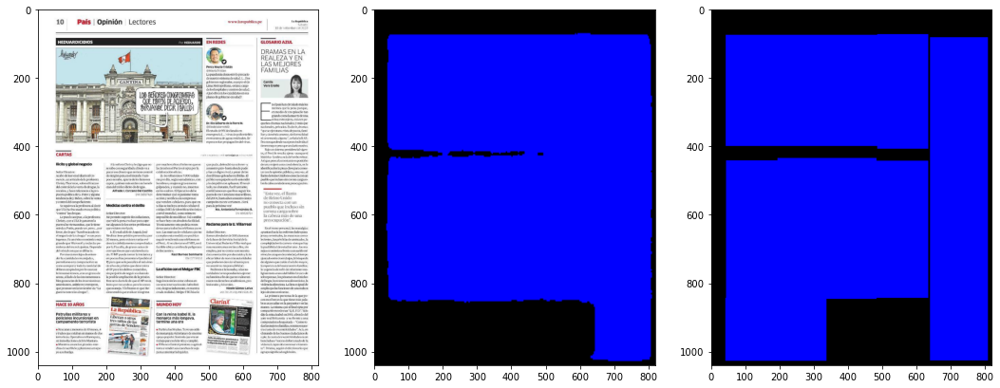

In [93]:
dir_1 = 'classes/1'

predict_images_in_directory_2(dir_1, model)

### 2: 'política'

Found 10 images in directory 'classes/2'
 -background: 14%
 -política: 85%


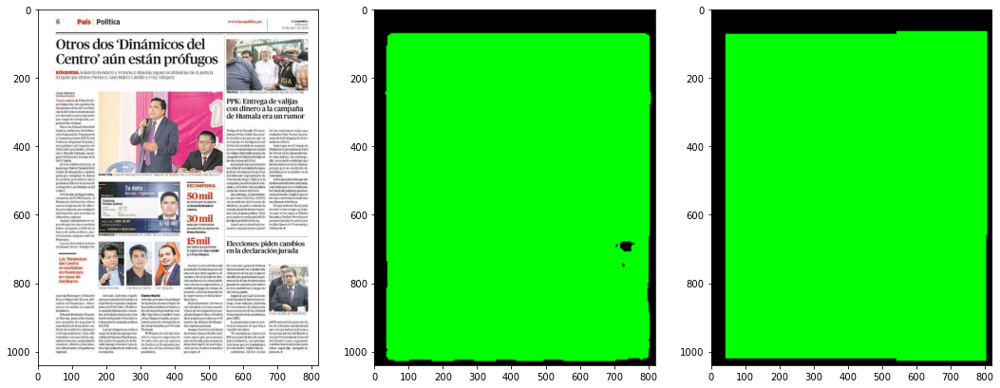

 -background: 13%
 -política: 86%


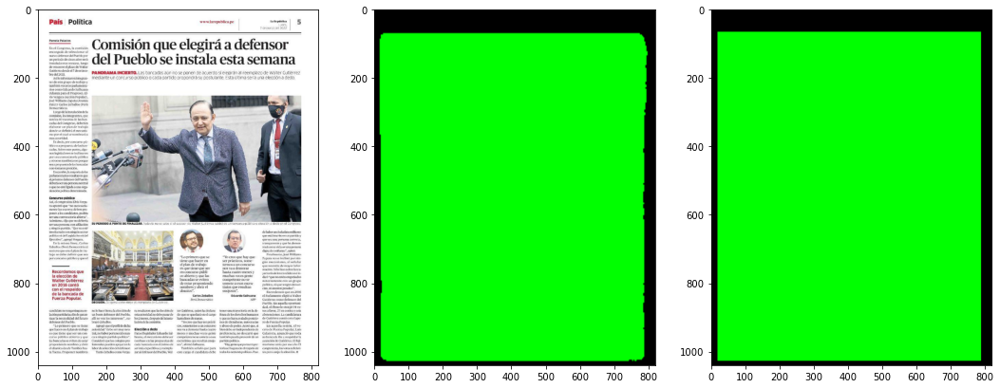

 -background: 20%
 -política: 79%


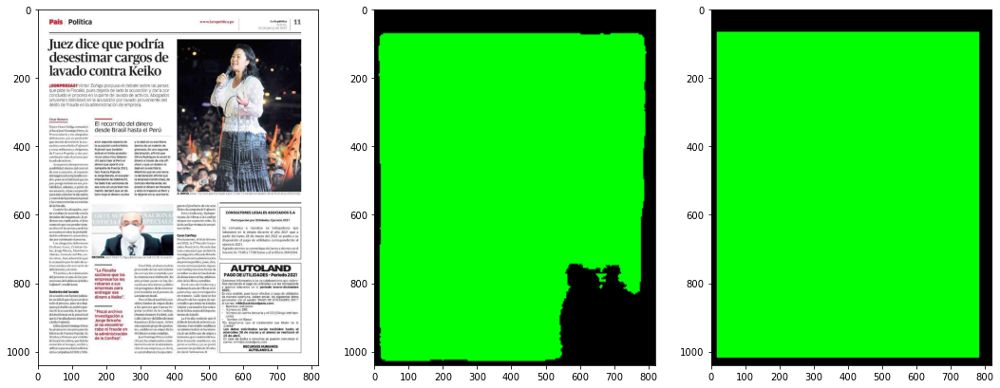

 -background: 14%
 -política: 85%


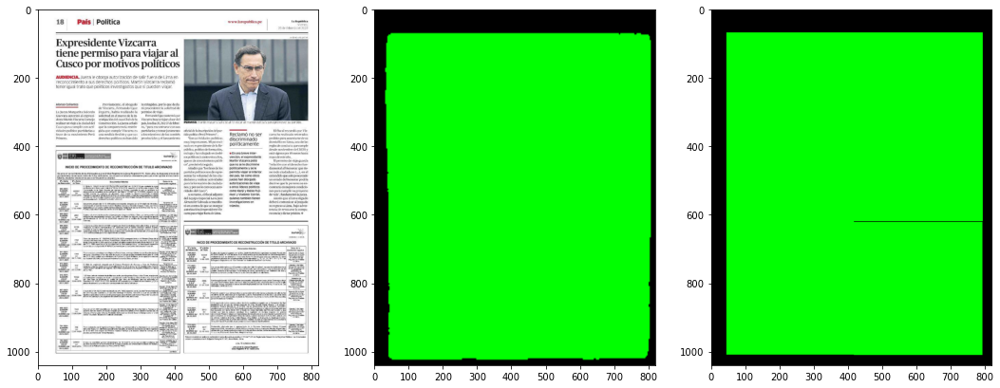

 -background: 13%
 -política: 86%


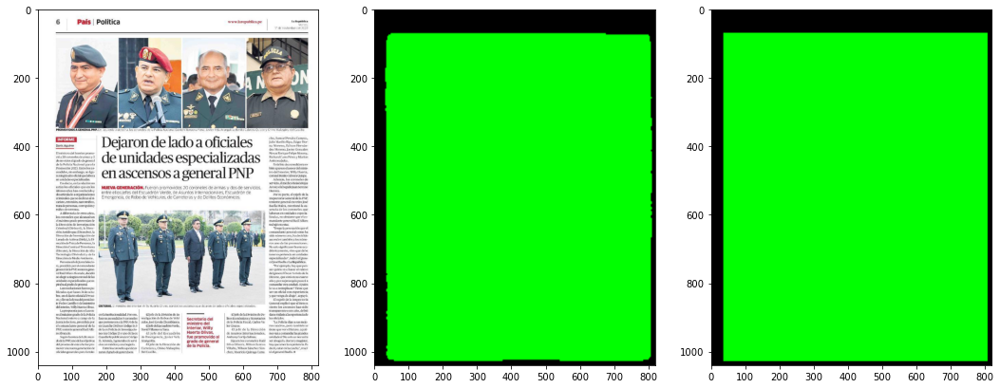

 -background: 13%
 -política: 86%


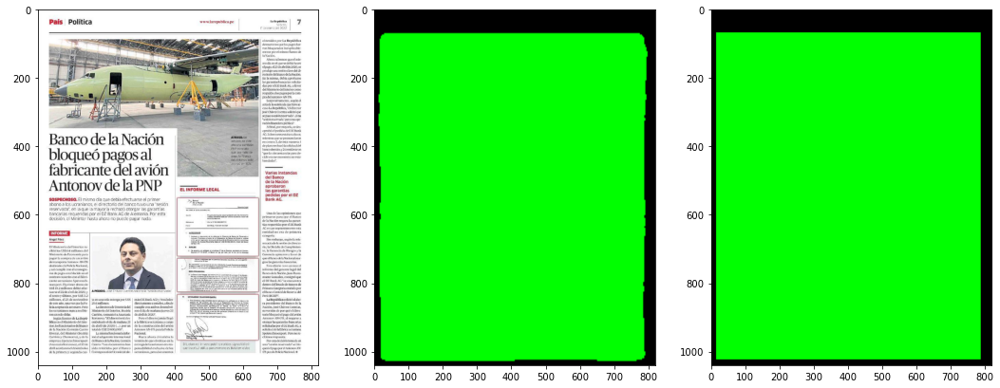

 -background: 13%
 -política: 86%


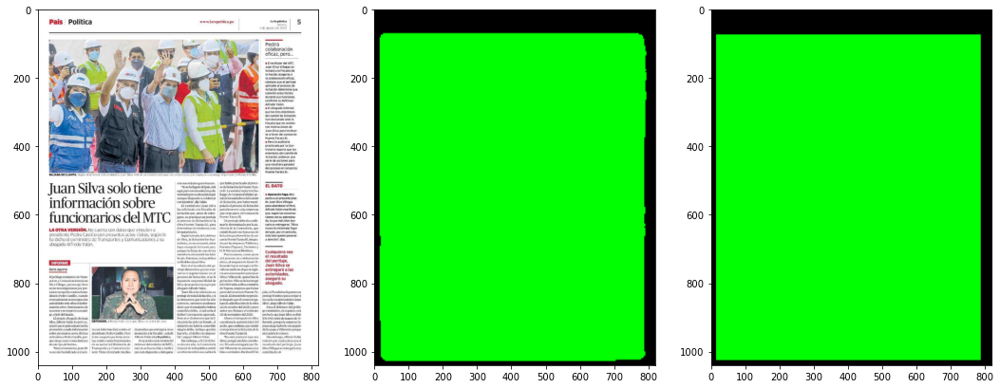

 -background: 14%
 -política: 85%


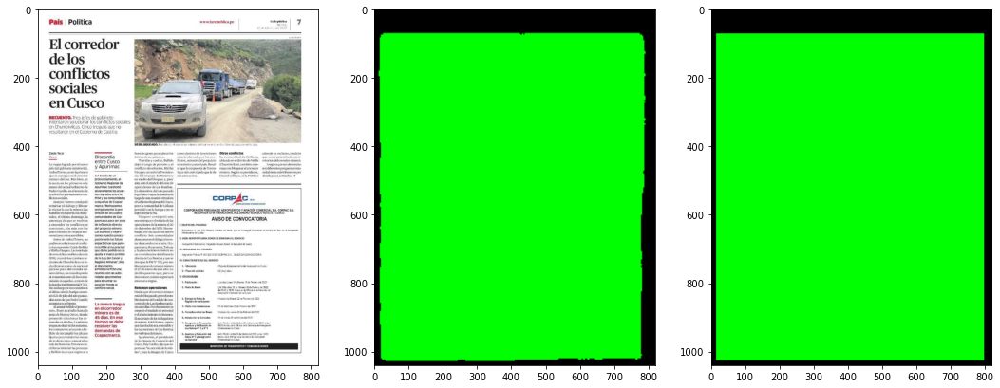

 -background: 14%
 -política: 85%


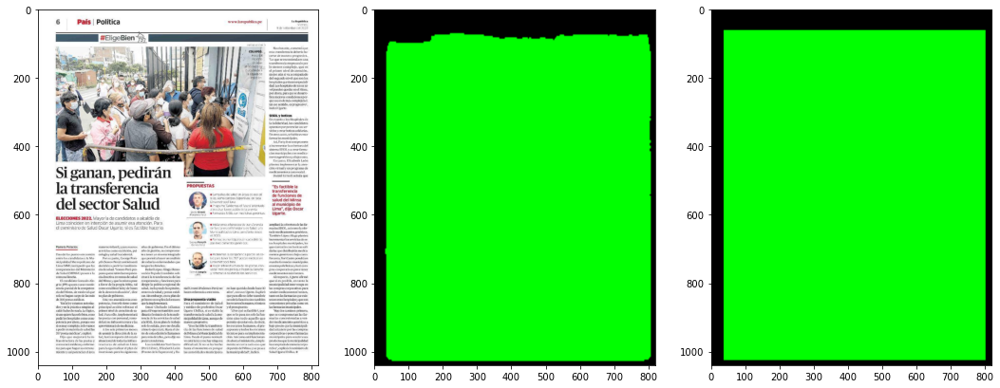

 -background: 15%
 -política: 84%


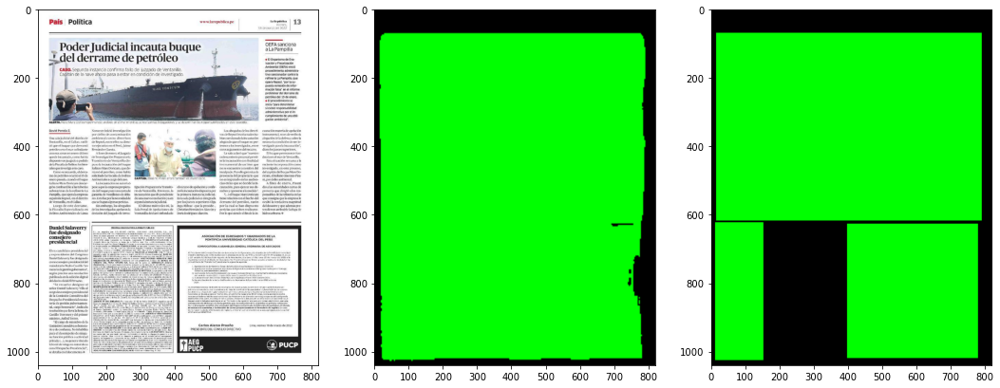

In [85]:
dir_2 = 'classes/2'

predict_images_in_directory_2(dir_2, model)

### 3: 'portada'

Found 10 images in directory 'classes/3'
 -background: 7%
 -portada: 92%


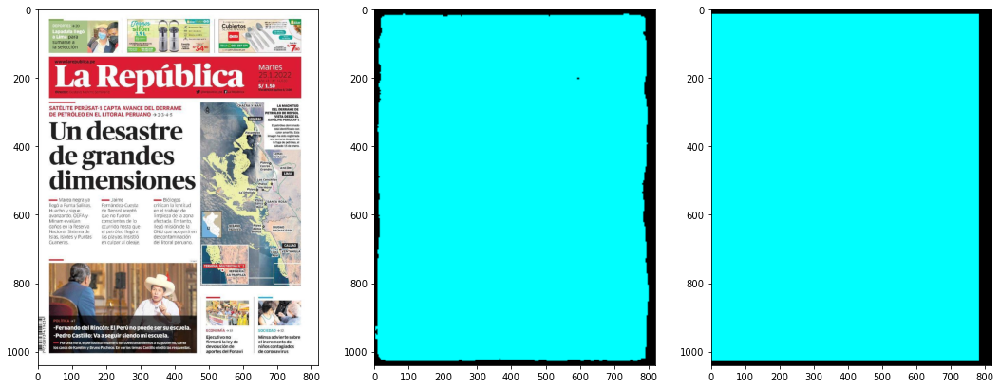

 -background: 7%
 -portada: 92%


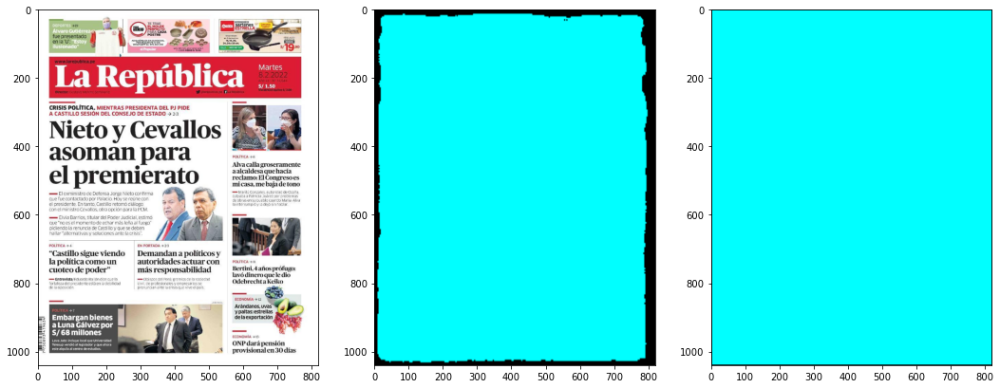

 -background: 7%
 -portada: 92%


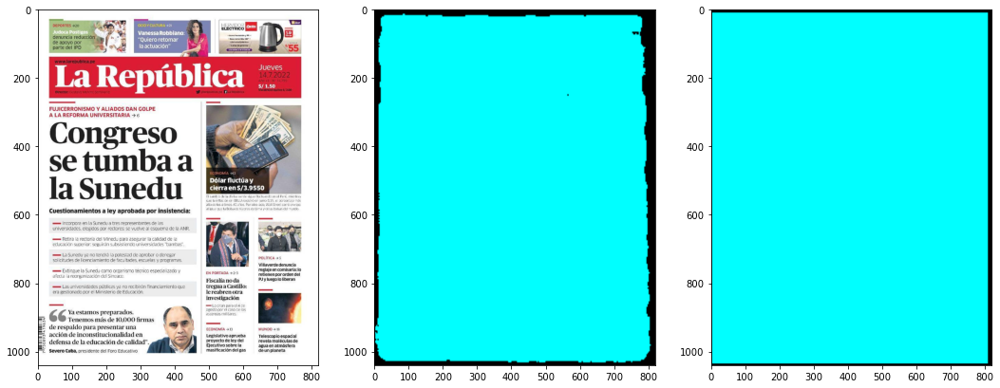

 -background: 6%
 -portada: 93%


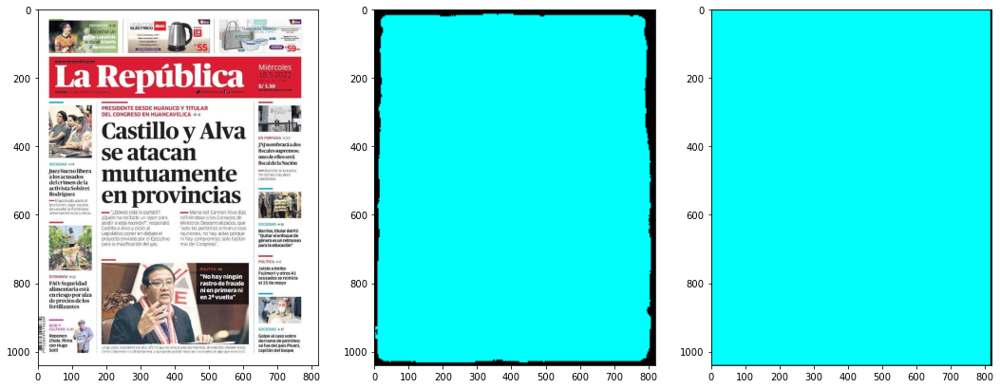

 -background: 8%
 -portada: 91%


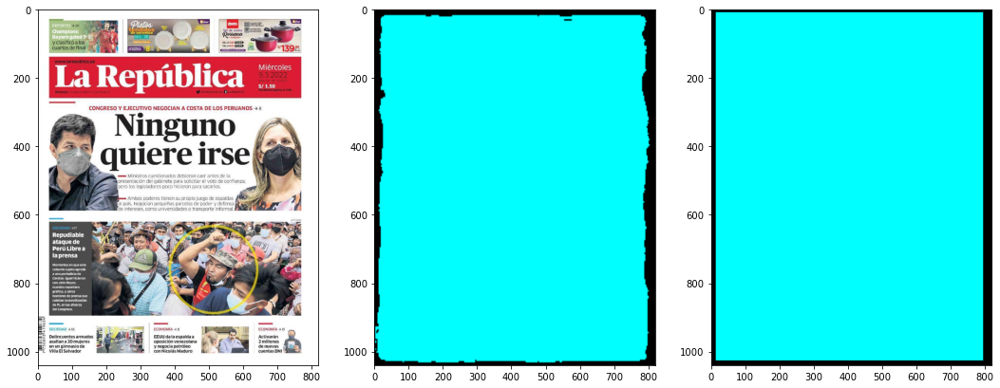

 -background: 6%
 -portada: 93%


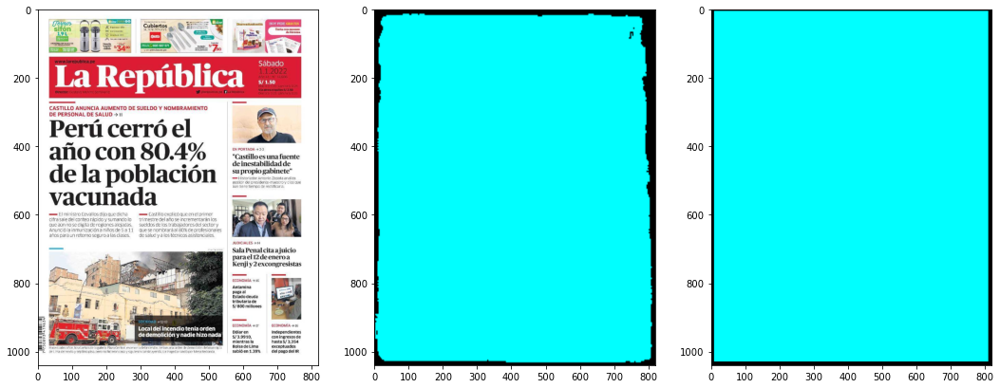

 -background: 7%
 -portada: 92%


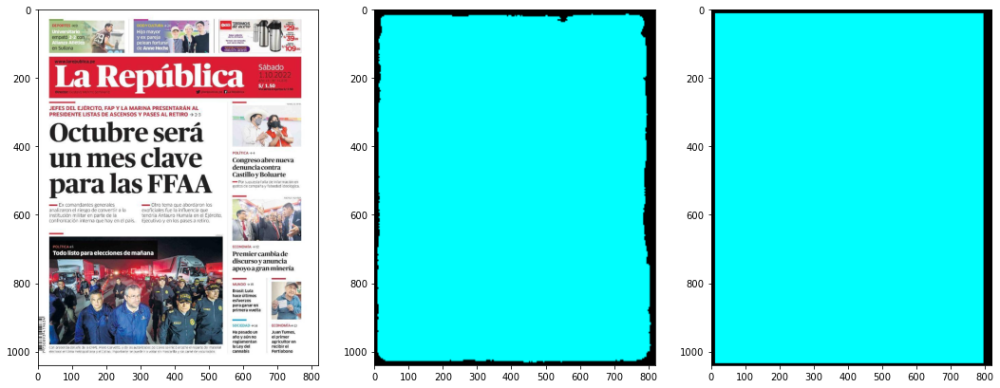

 -background: 7%
 -portada: 92%


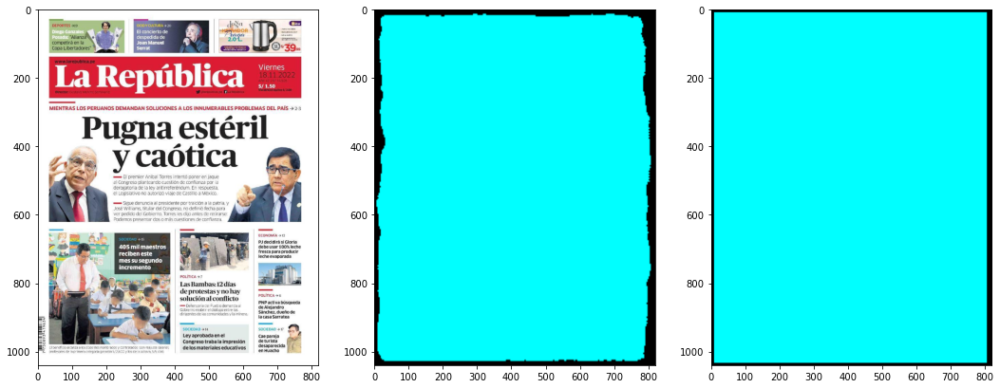

 -background: 7%
 -portada: 72%
 -otros: 20%


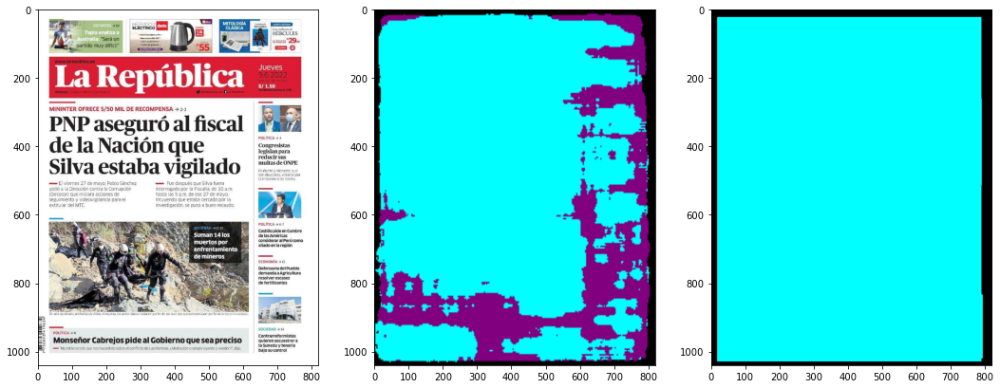

 -background: 7%
 -portada: 92%


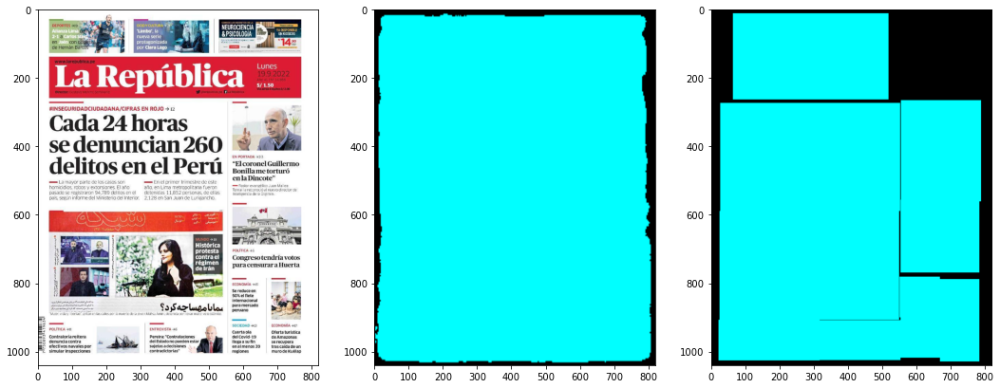

In [86]:
dir_3 = 'classes/3'

predict_images_in_directory_2(dir_3, model)

### 4: 'economía'

Found 10 images in directory 'classes/4'
 -background: 14%
 -economía: 85%


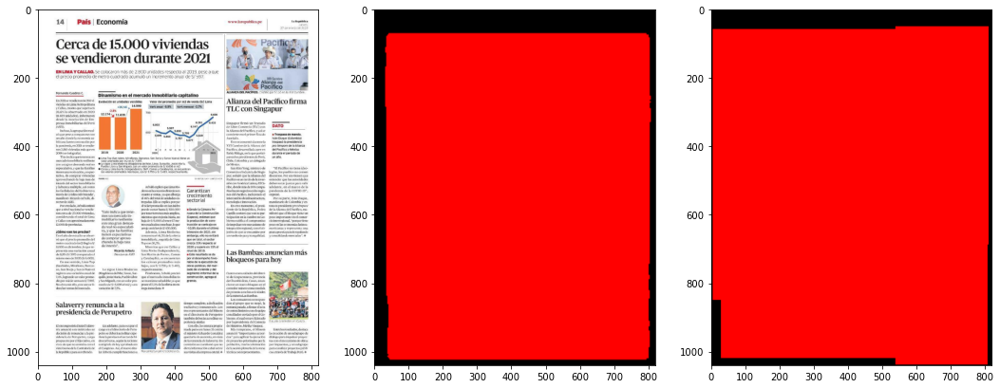

 -background: 14%
 -política: 85%


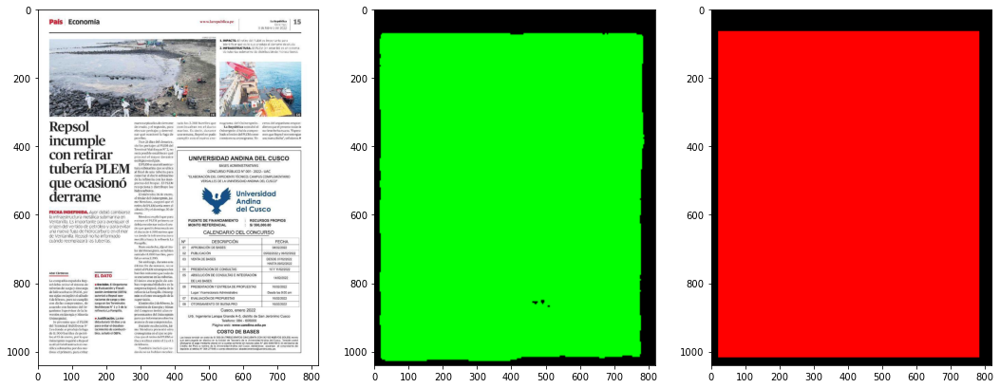

 -background: 25%
 -política: 53%
 -economía: 21%


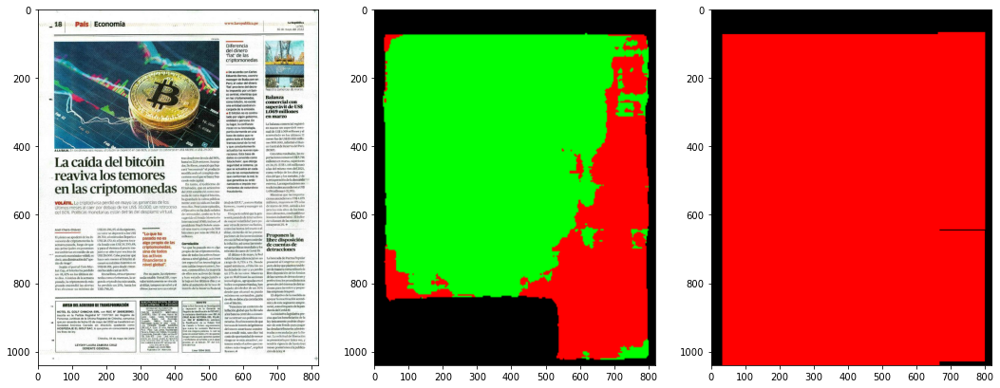

 -background: 14%
 -política: 46%
 -economía: 39%


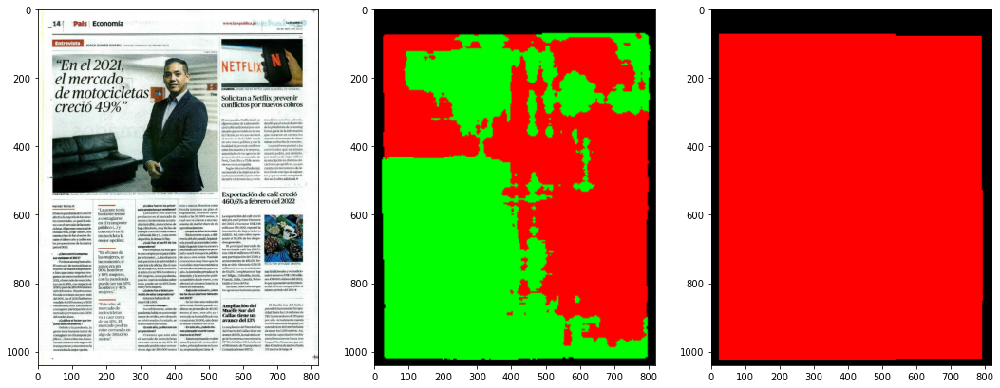

 -background: 14%
 -economía: 85%


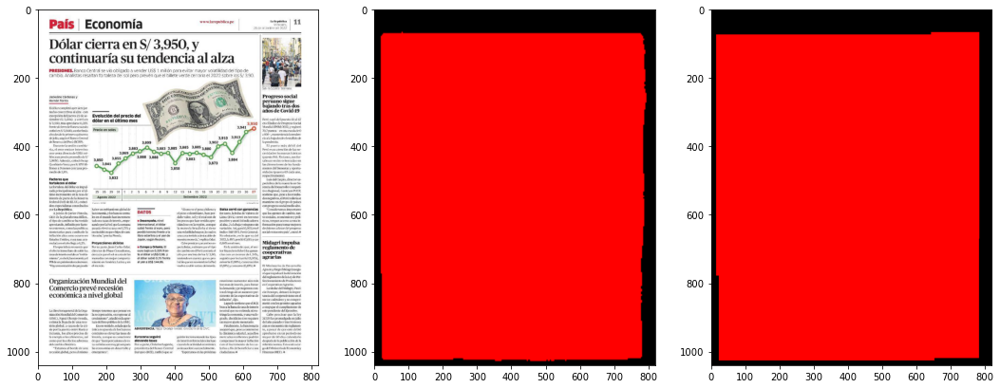

 -background: 16%
 -política: 38%
 -economía: 45%


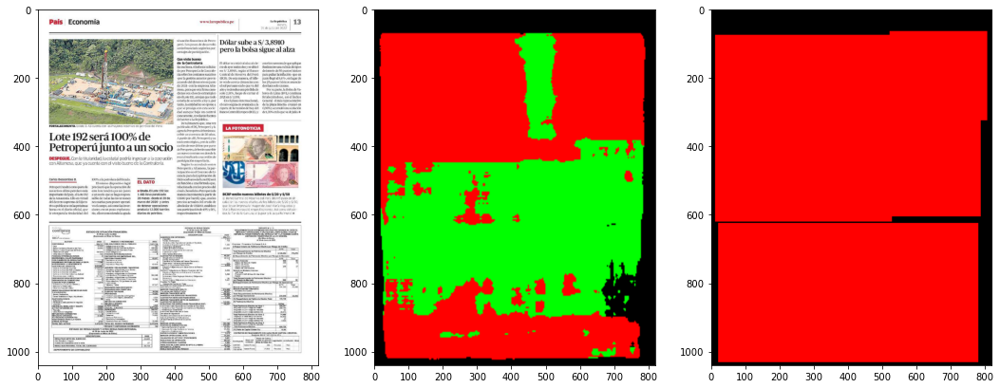

 -background: 14%
 -política: 42%
 -economía: 43%


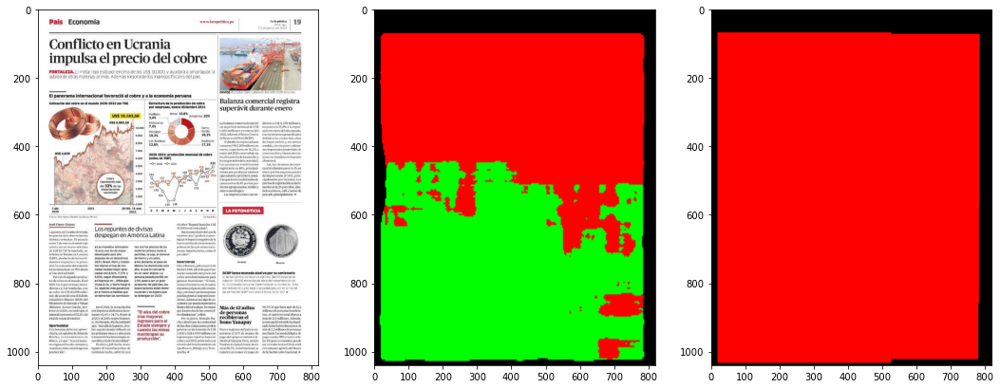

 -background: 14%
 -economía: 85%


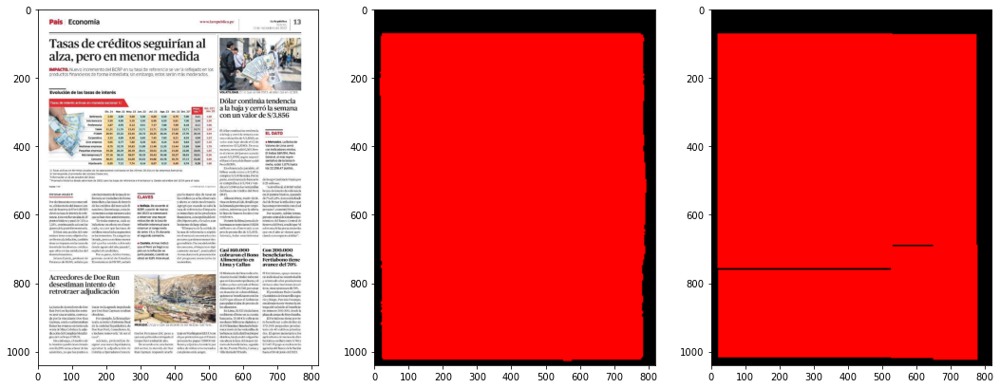

 -background: 14%
 -política: 44%
 -economía: 41%


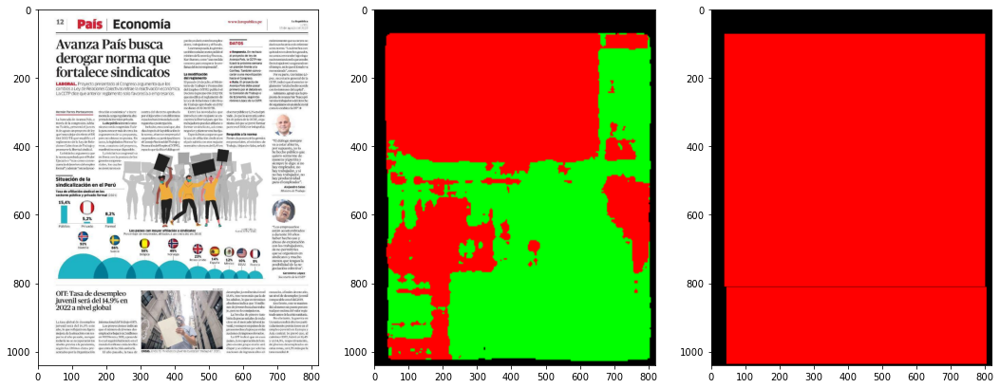

 -background: 14%
 -política: 30%
 -economía: 54%


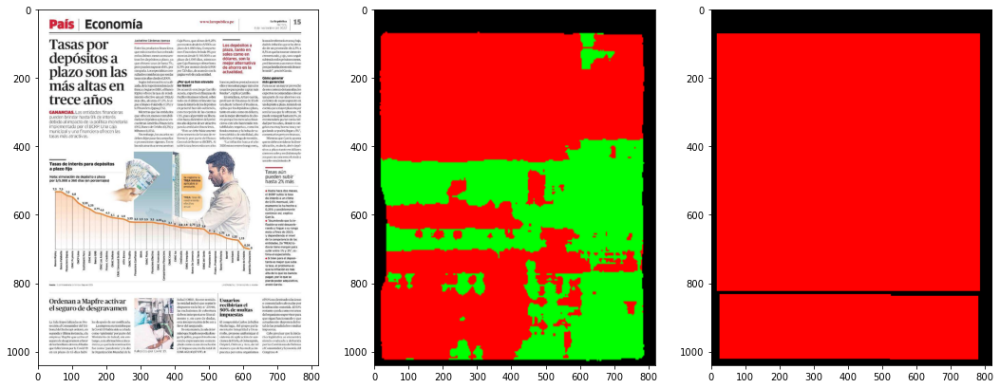

In [87]:
dir_4 = 'classes/4'

predict_images_in_directory_2(dir_4, model)

### 5: 'sociedad'

Found 10 images in directory 'classes/5'
 -background: 13%
 -política: 47%
 -sociedad: 39%


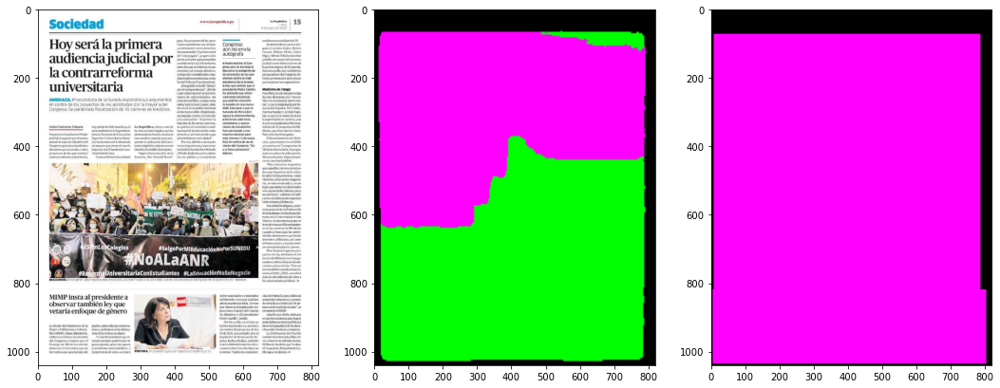

 -background: 28%
 -sociedad: 71%


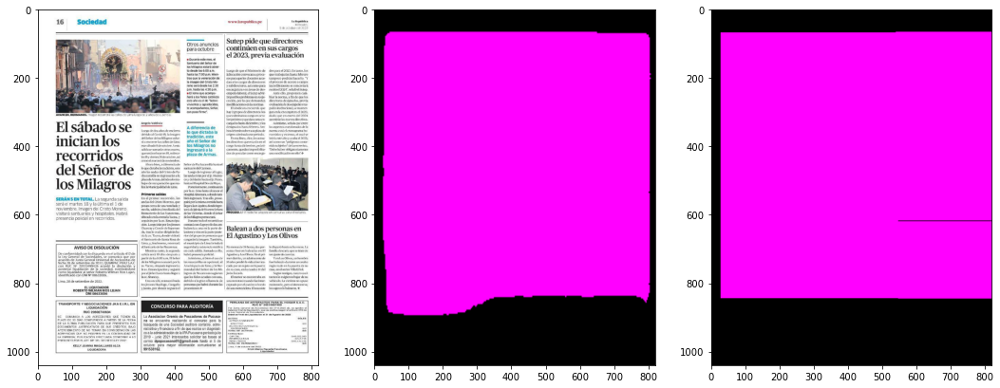

 -background: 12%
 -sociedad: 87%


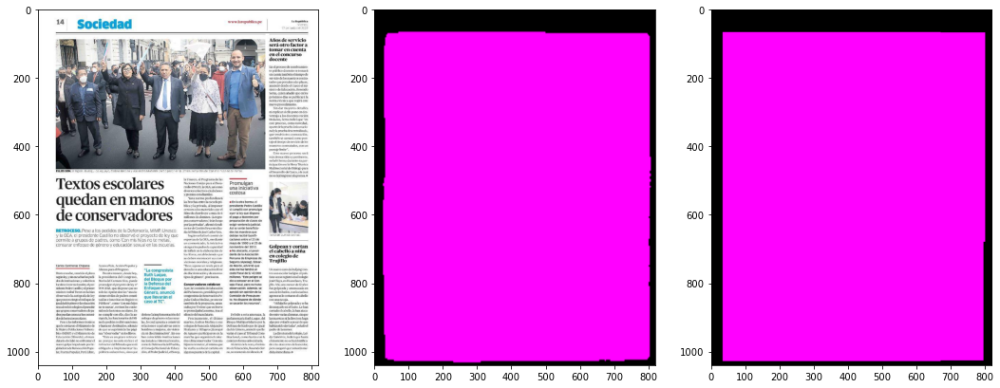

 -background: 13%
 -sociedad: 86%


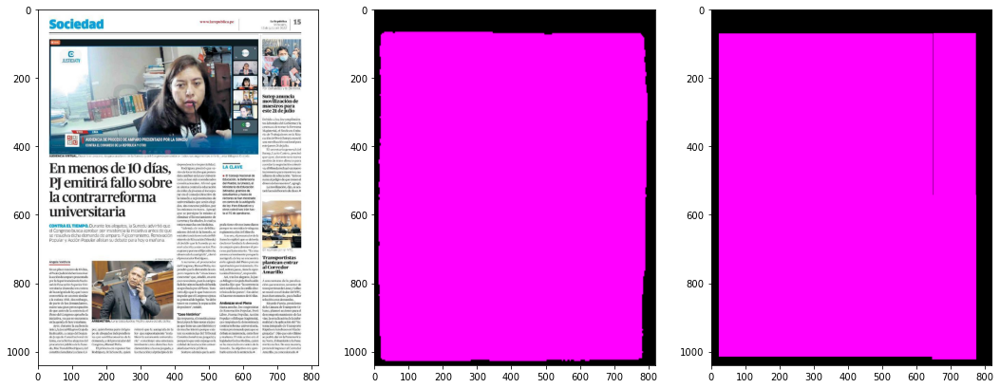

 -background: 14%
 -economía: 32%
 -sociedad: 52%


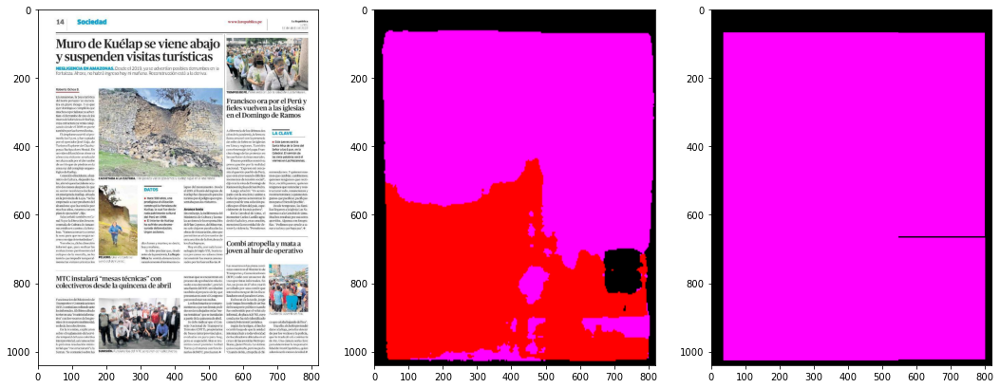

 -background: 13%
 -política: 45%
 -sociedad: 41%


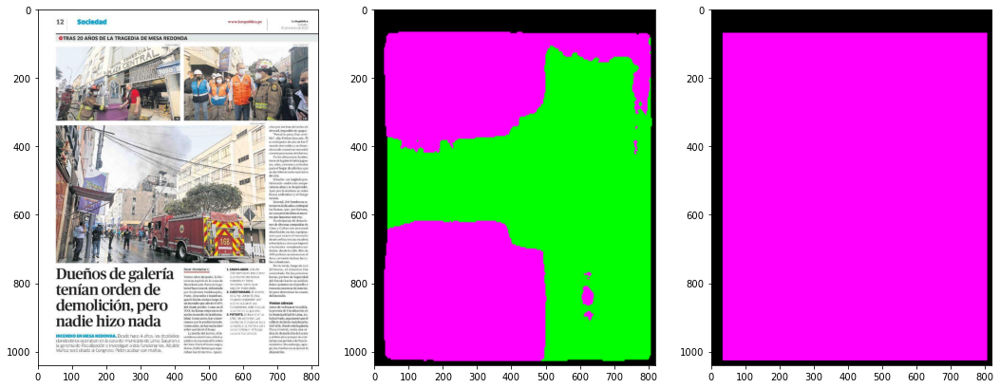

 -background: 12%
 -sociedad: 87%


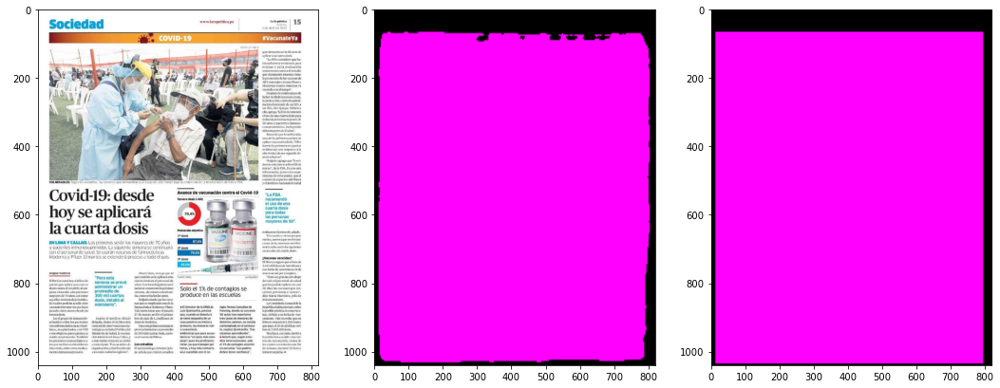

 -background: 13%
 -sociedad: 86%


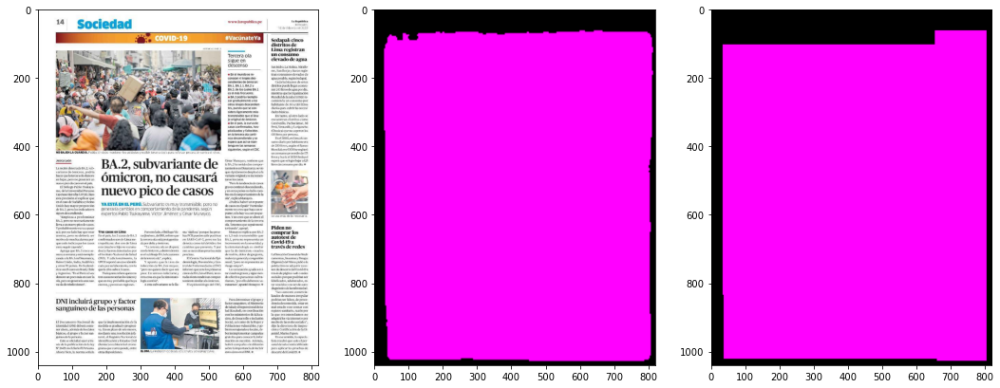

 -background: 12%
 -sociedad: 87%


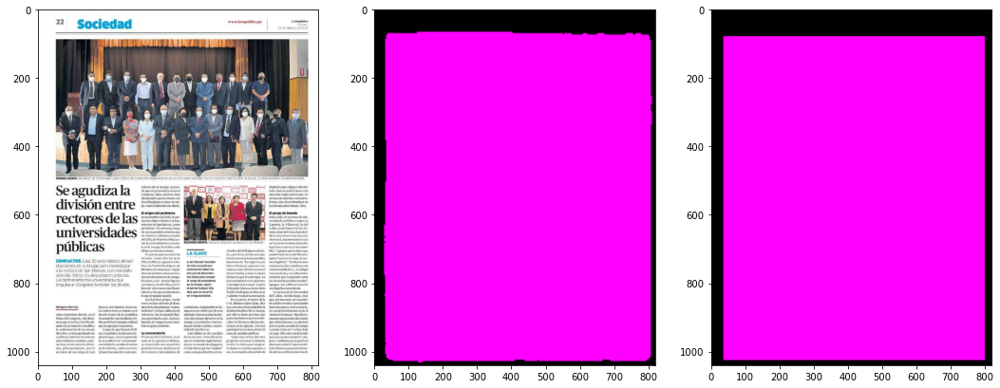

 -background: 12%
 -economía: 23%
 -sociedad: 63%


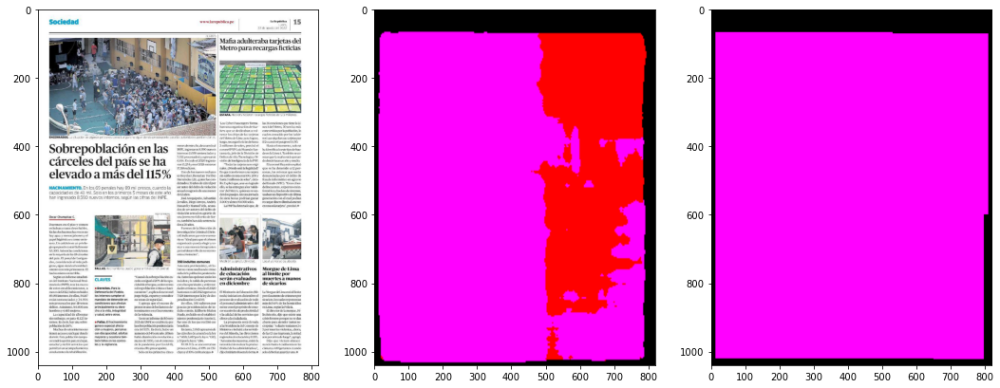

In [88]:
dir_5 = 'classes/5'

predict_images_in_directory_2(dir_5, model)

### 6: 'en portada'

Found 10 images in directory 'classes/6'
 -background: 16%
 -política: 48%
 -en portada: 35%


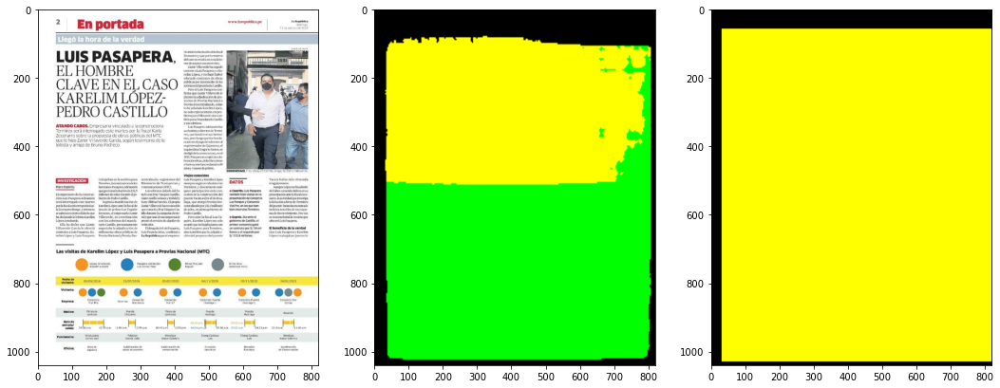

 -background: 16%
 -política: 32%
 -en portada: 44%
 -otros: 6%


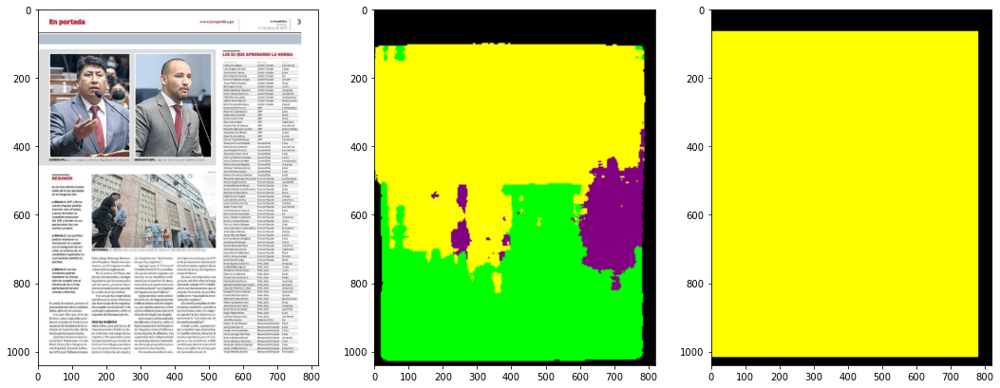

 -background: 15%
 -política: 36%
 -en portada: 47%


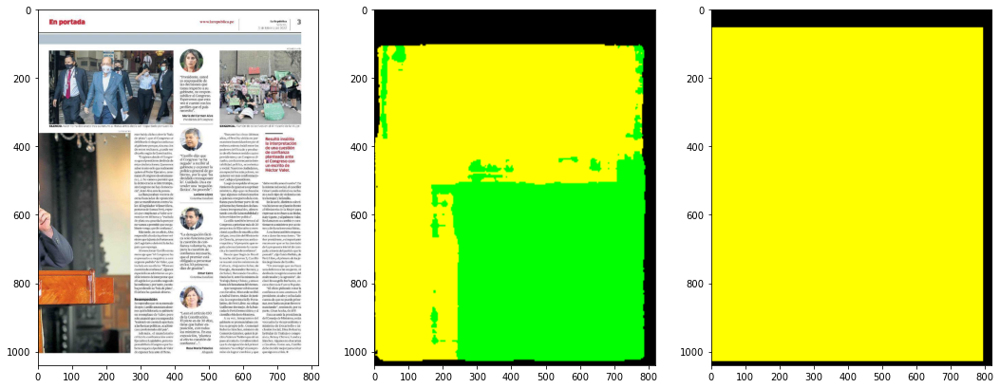

 -background: 14%
 -política: 49%
 -en portada: 35%


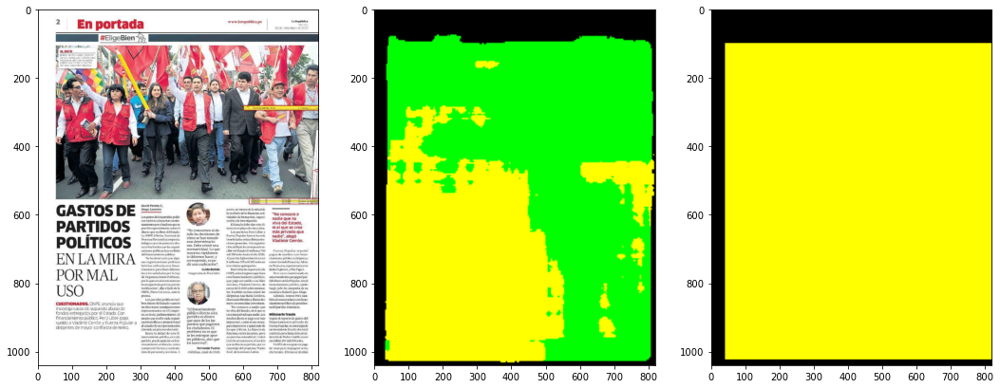

 -background: 16%
 -política: 25%
 -en portada: 41%
 -otros: 15%


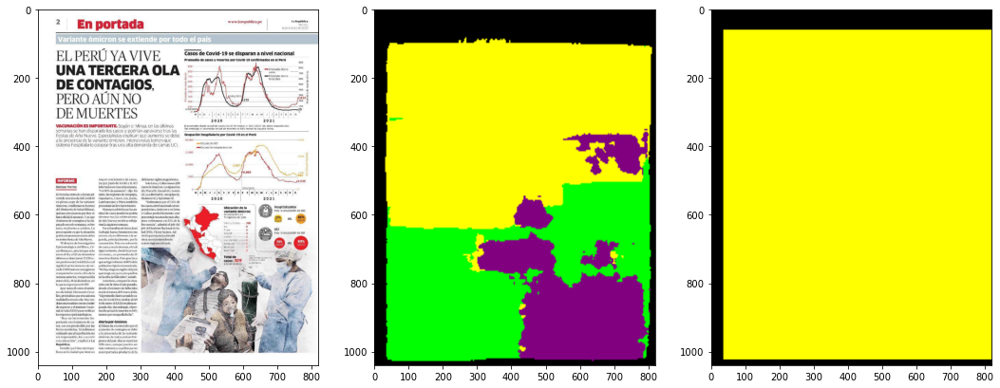

 -background: 14%
 -política: 20%
 -en portada: 64%


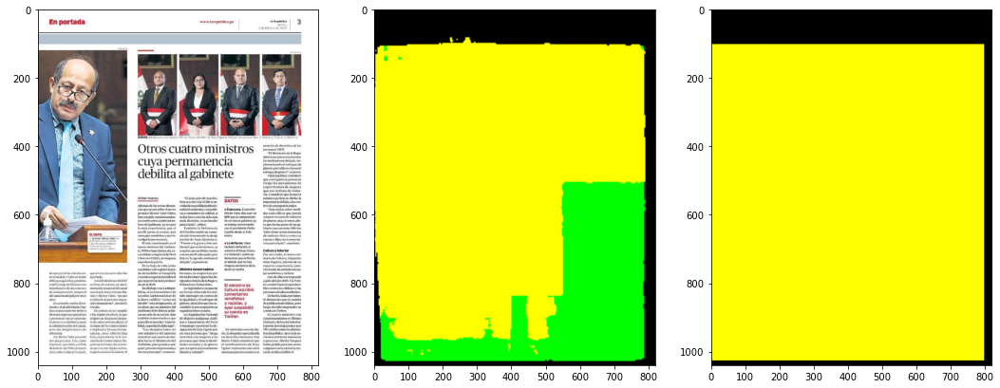

 -background: 17%
 -política: 50%
 -economía: 19%
 -sociedad: 12%


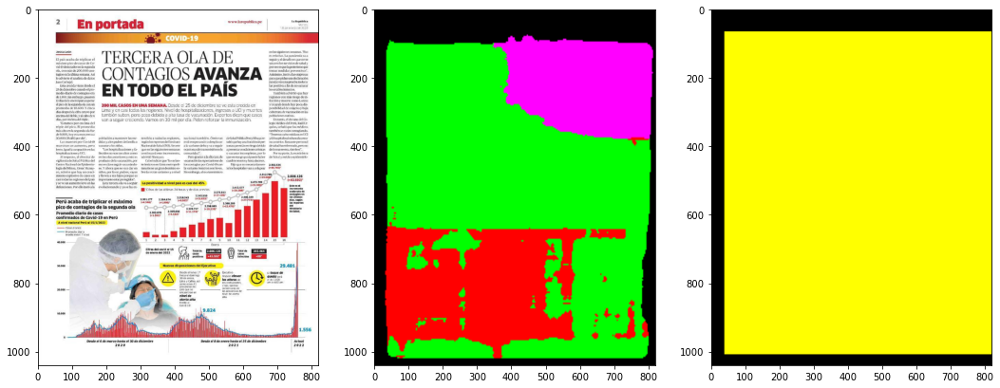

 -background: 16%
 -política: 24%
 -en portada: 59%


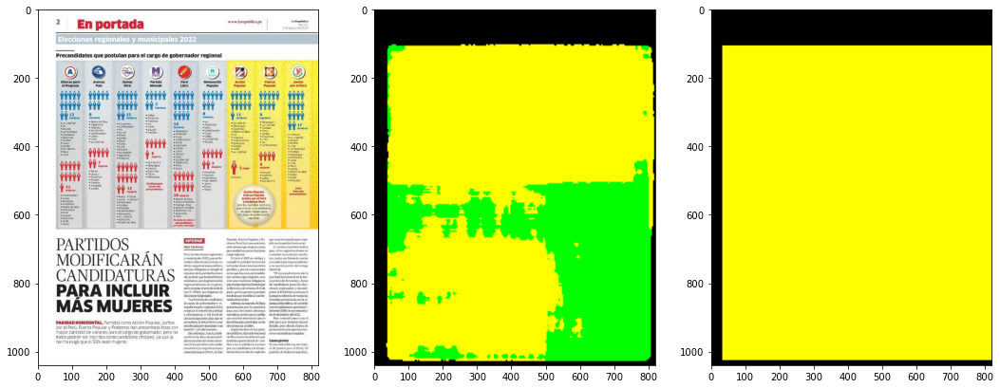

 -background: 16%
 -política: 45%
 -en portada: 37%


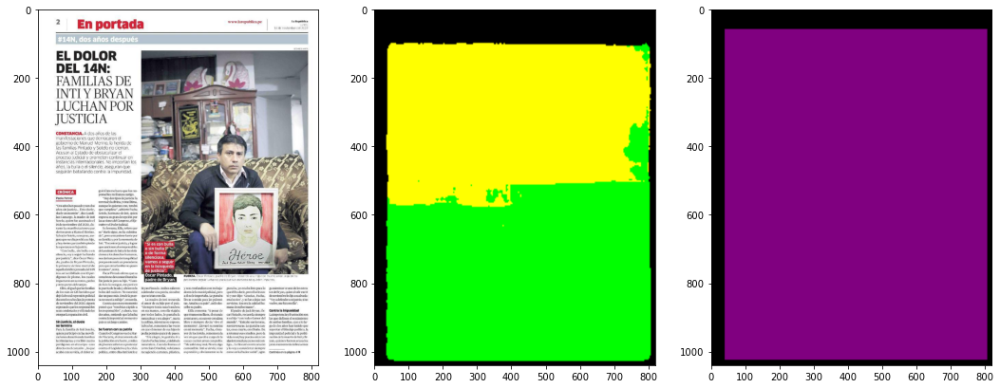

 -background: 13%
 -política: 86%


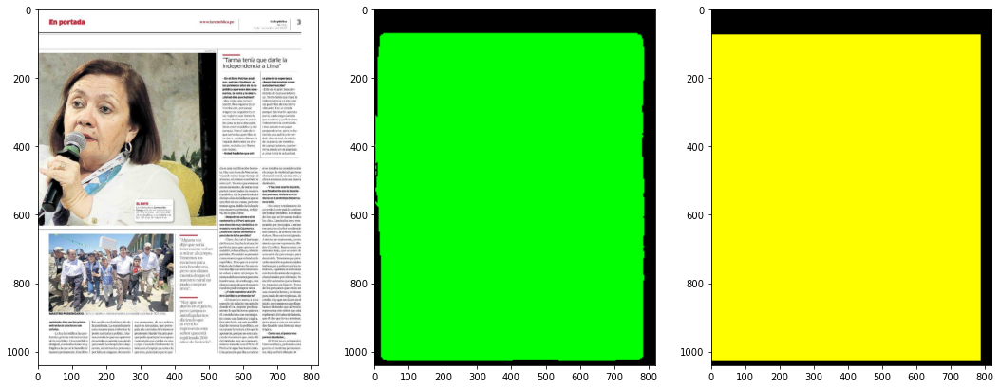

In [89]:
dir_6 = 'classes/6'

predict_images_in_directory_2(dir_6, model)

### 7: 'deportes'

Found 6 images in directory 'classes/7'
 -background: 14%
 -política: 61%
 -otros: 24%


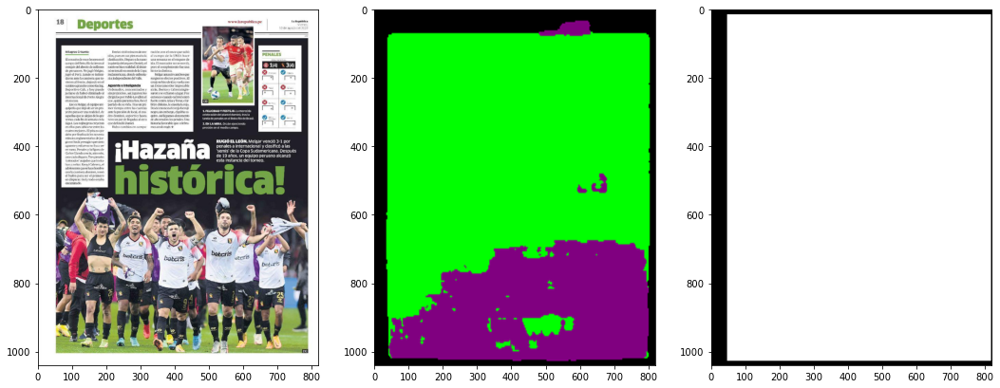

 -background: 19%
 -política: 45%
 -economía: 6%
 -en portada: 8%
 -otros: 20%


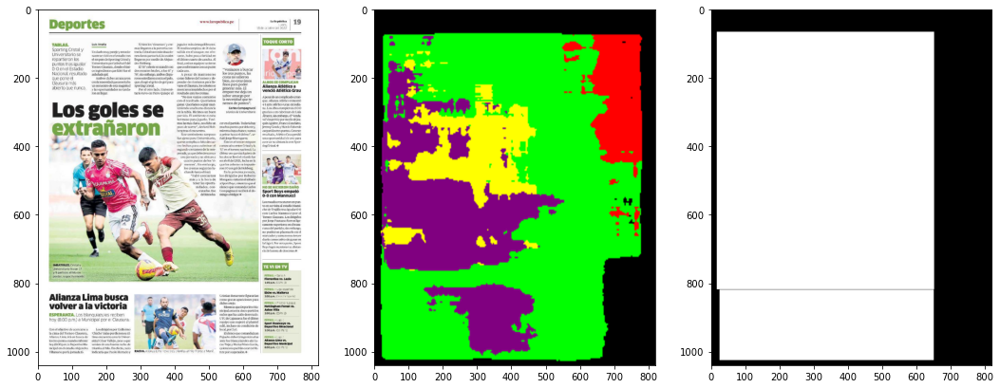

 -background: 23%
 -política: 76%


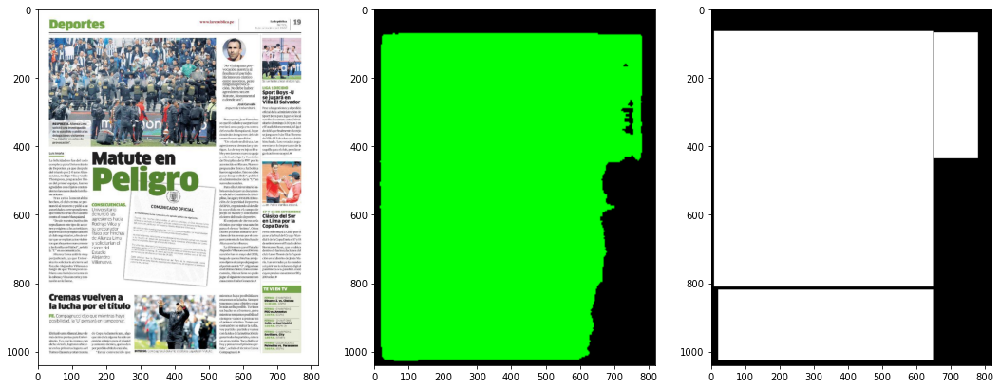

 -background: 13%
 -política: 86%


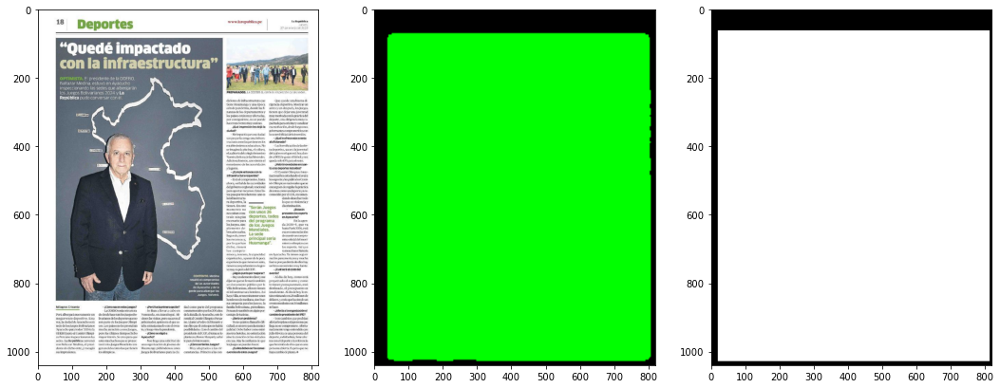

 -background: 15%
 -política: 84%


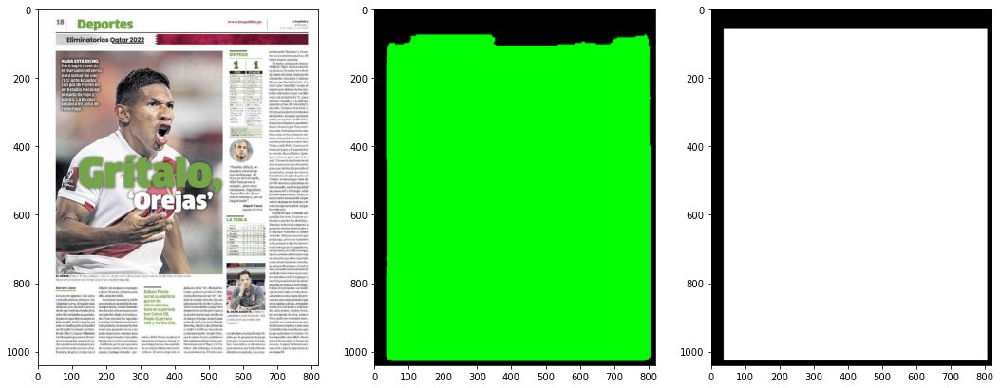

 -background: 13%
 -política: 86%


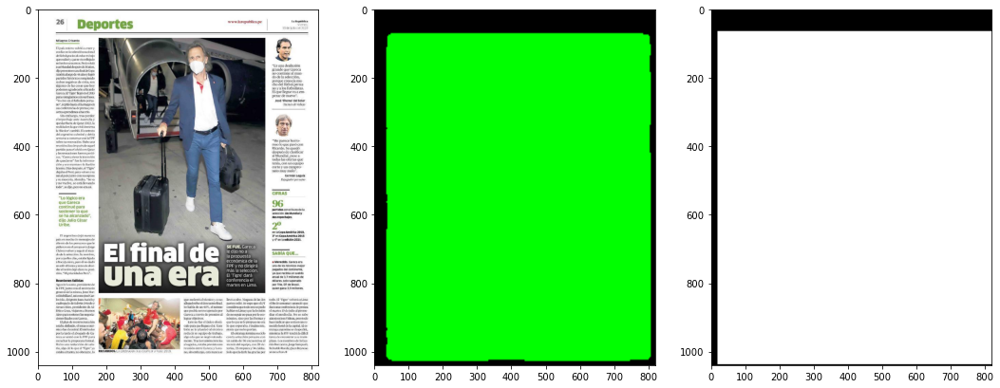

In [90]:
dir_7 = 'classes/7'

predict_images_in_directory_2(dir_7, model)

### 8: 'mundo'

Found 10 images in directory 'classes/8'
 -background: 13%
 -política: 86%


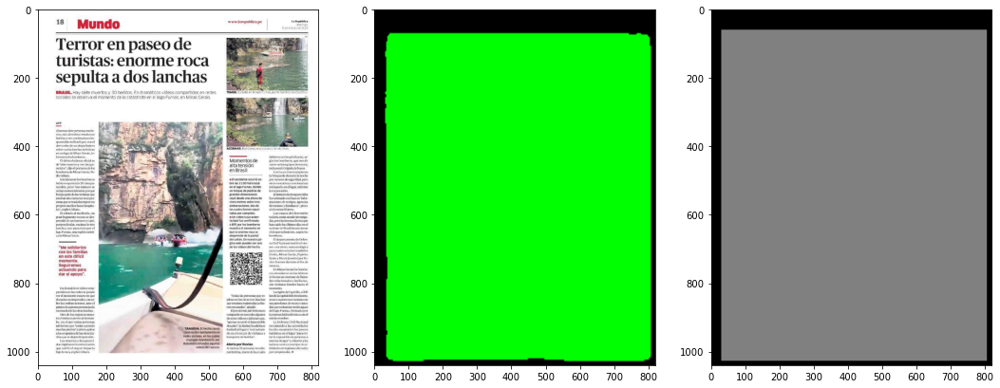

 -background: 14%
 -política: 85%


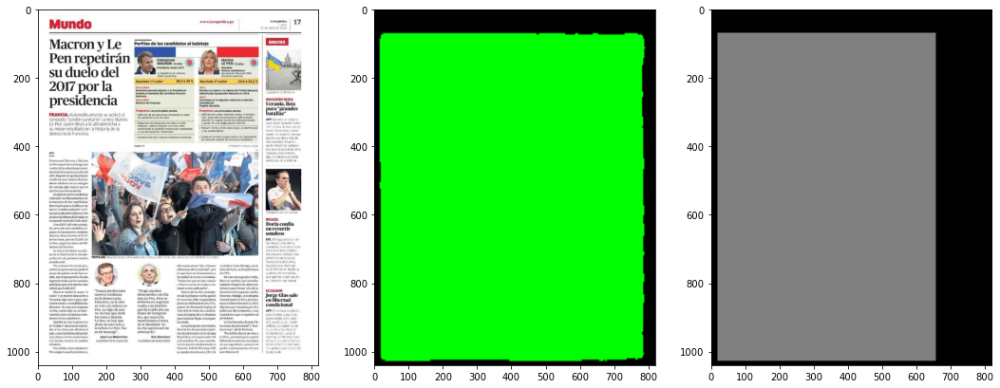

 -background: 13%
 -política: 86%


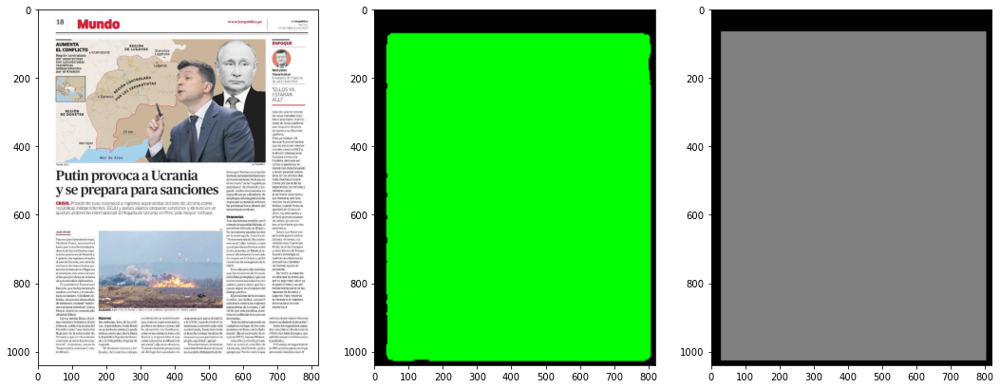

 -background: 18%
 -política: 61%
 -economía: 20%


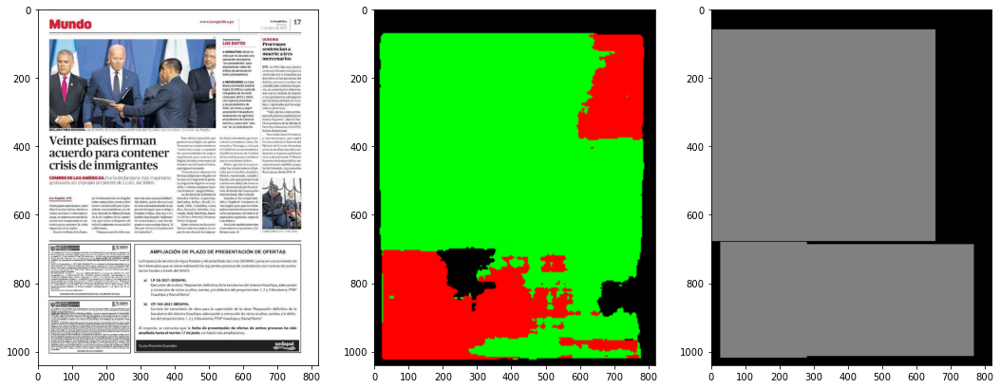

 -background: 14%
 -política: 85%


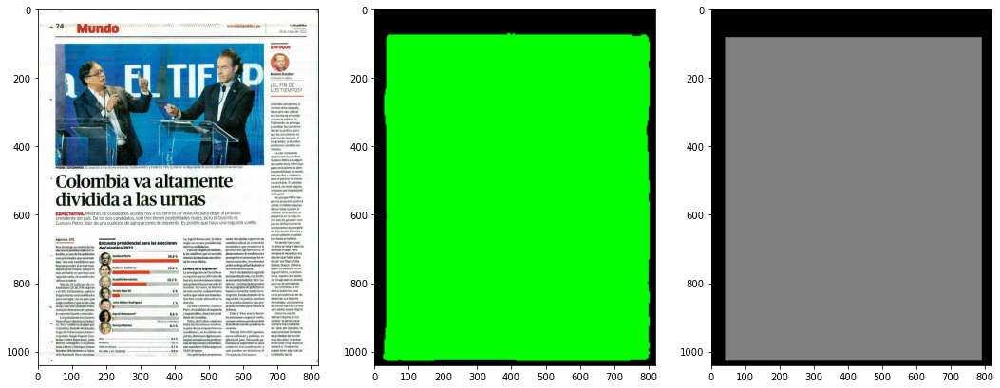

 -background: 14%
 -política: 85%


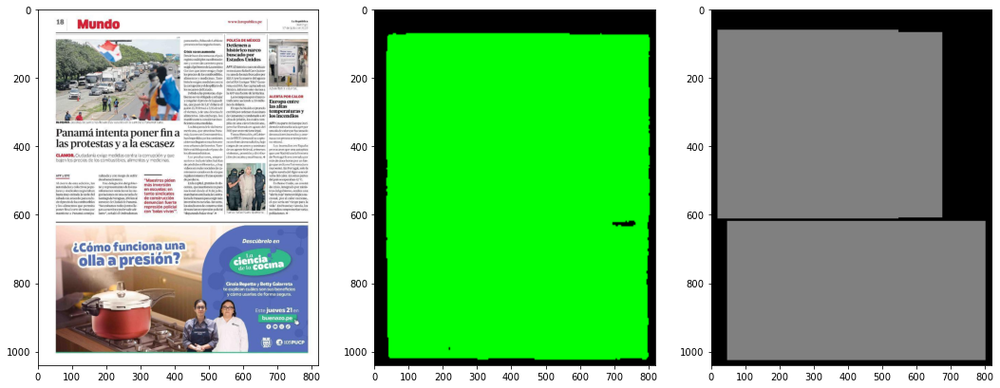

 -background: 15%
 -política: 84%


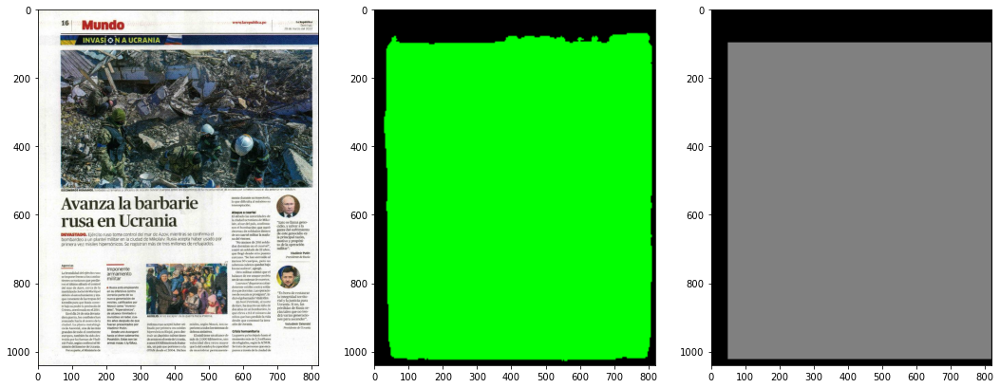

 -background: 13%
 -política: 86%


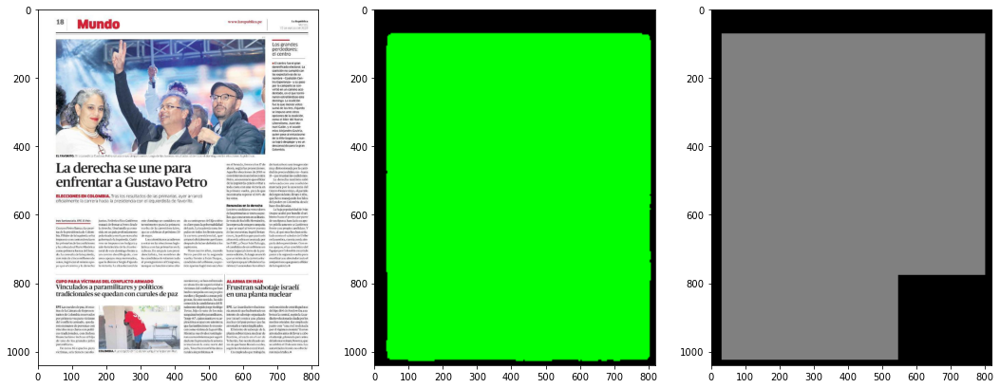

 -background: 13%
 -política: 86%


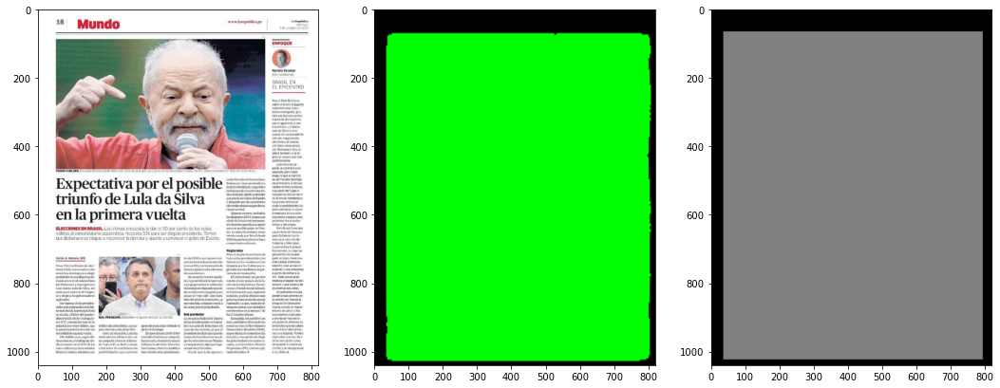

 -background: 14%
 -política: 85%


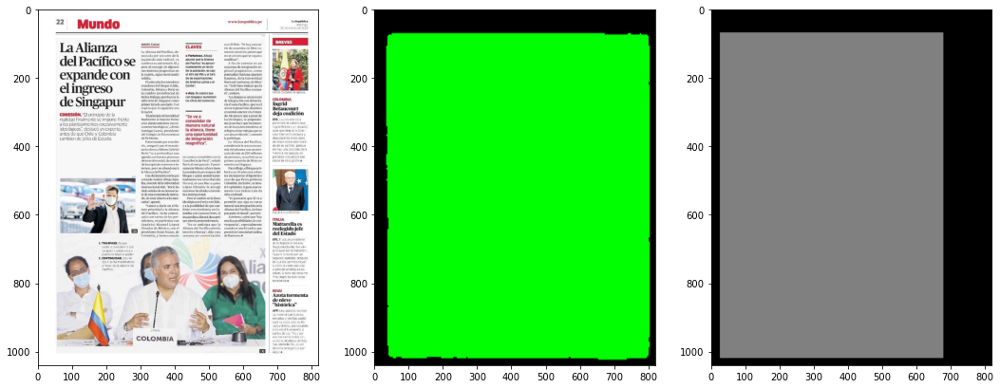

In [91]:
dir_8 = 'classes/8'

predict_images_in_directory_2(dir_8, model)

### 9: 'ocio y cultura'

Found 2 images in directory 'classes/9'
 -background: 23%
 -política: 76%


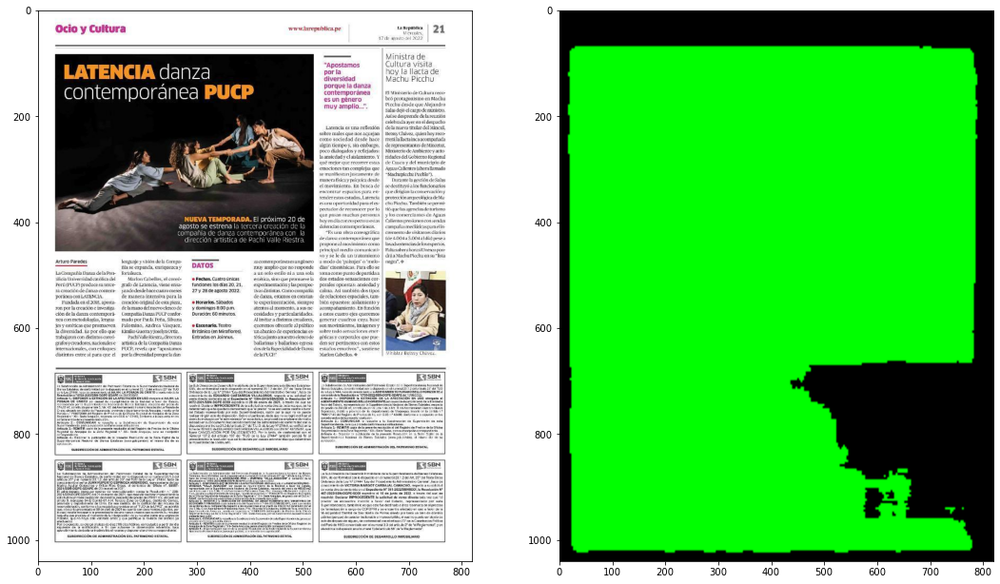

 -background: 18%
 -política: 81%


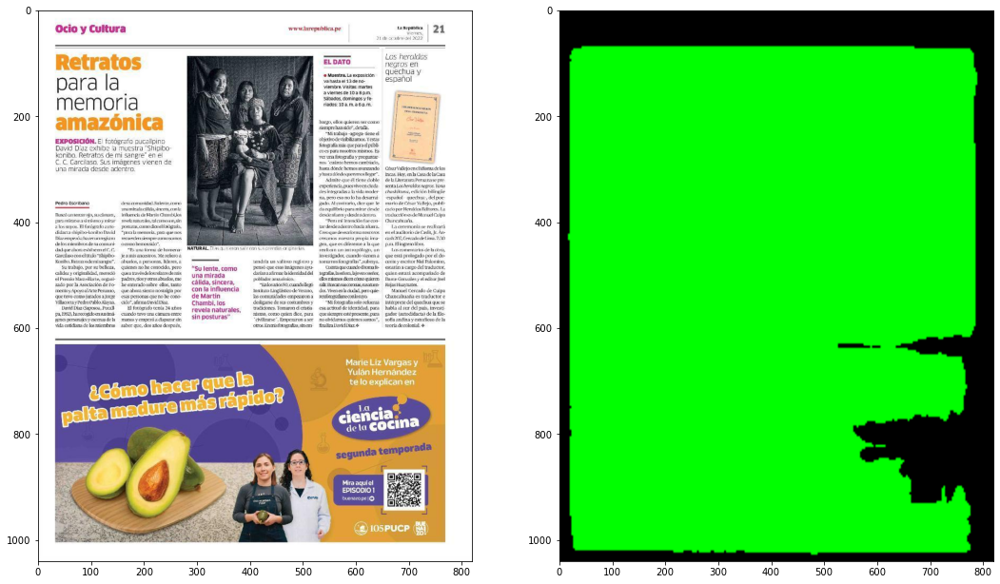

In [92]:
dir_9 = 'classes/9'

predict_images_in_directory(dir_9, model)

### 10: 'otros'

In [ ]:
dir_10 = 'classes/10'

predict_images_in_directory(dir_10, model)

## Per month

In [24]:
directory = 'new/2021/10/03/la república (lima, perú)/'

 -background: 14%
 -política: 55%
 -otros: 29%


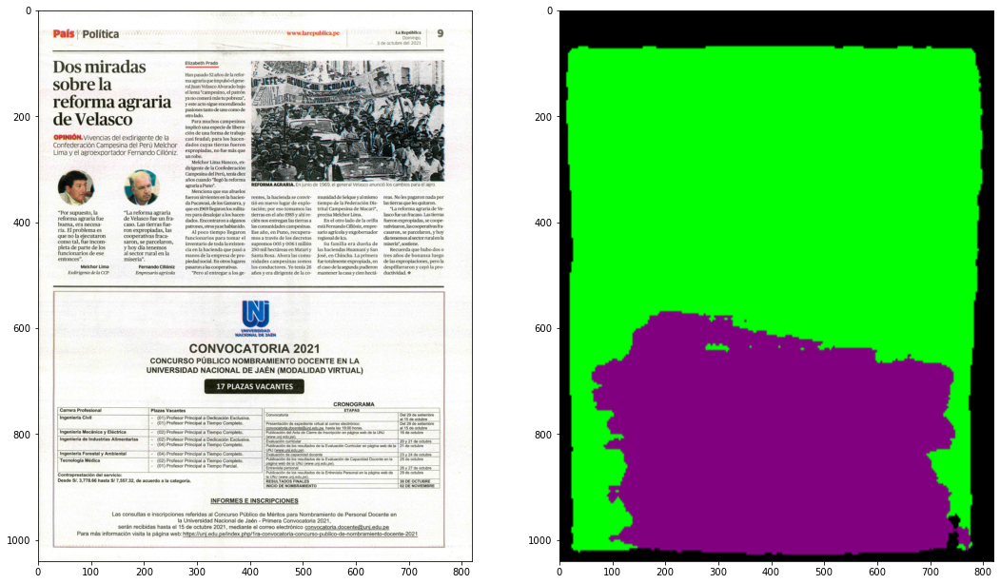

 -background: 16%
 -política: 31%
 -en portada: 27%
 -otros: 24%


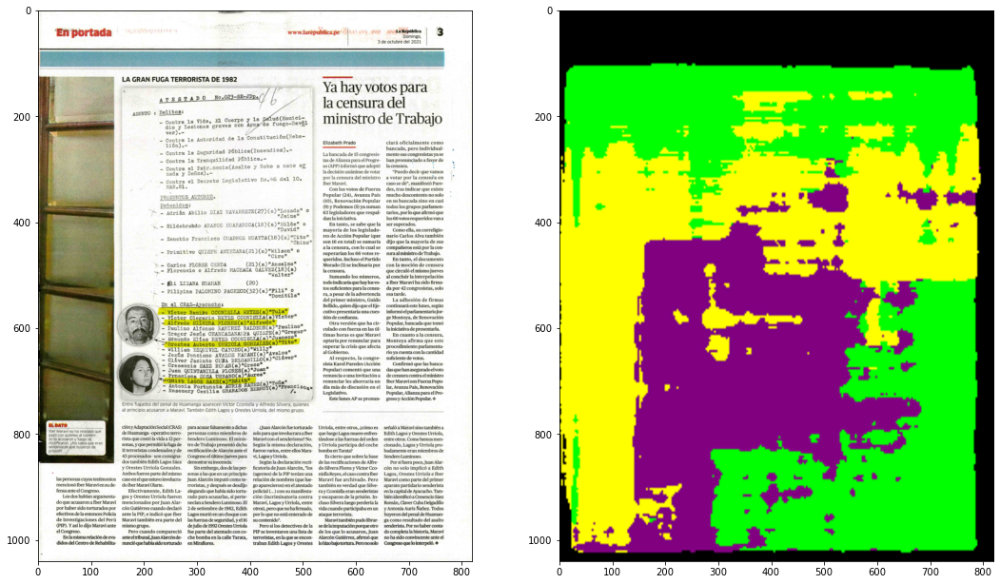

 -background: 14%
 -política: 85%


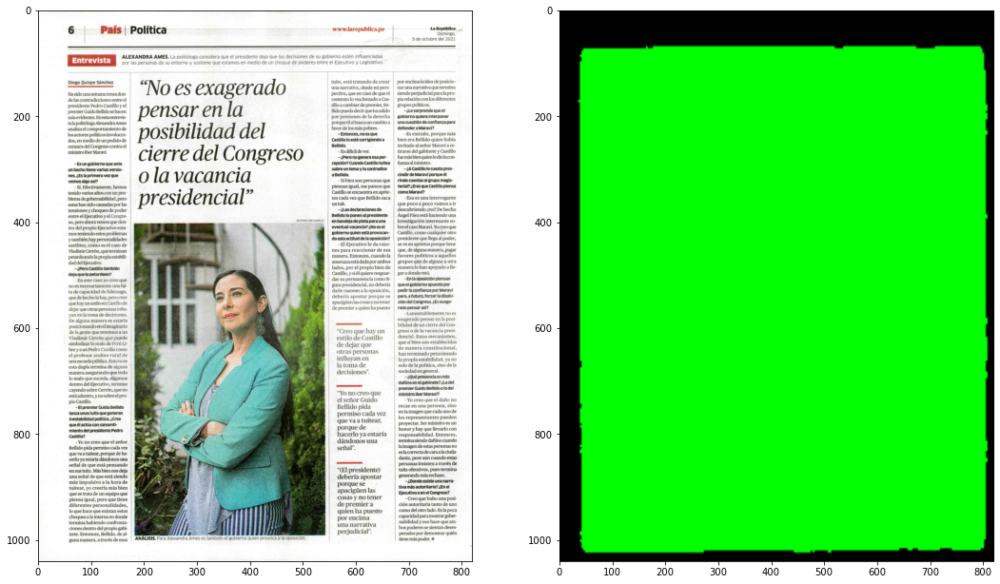

 -background: 14%
 -política: 23%
 -sociedad: 61%


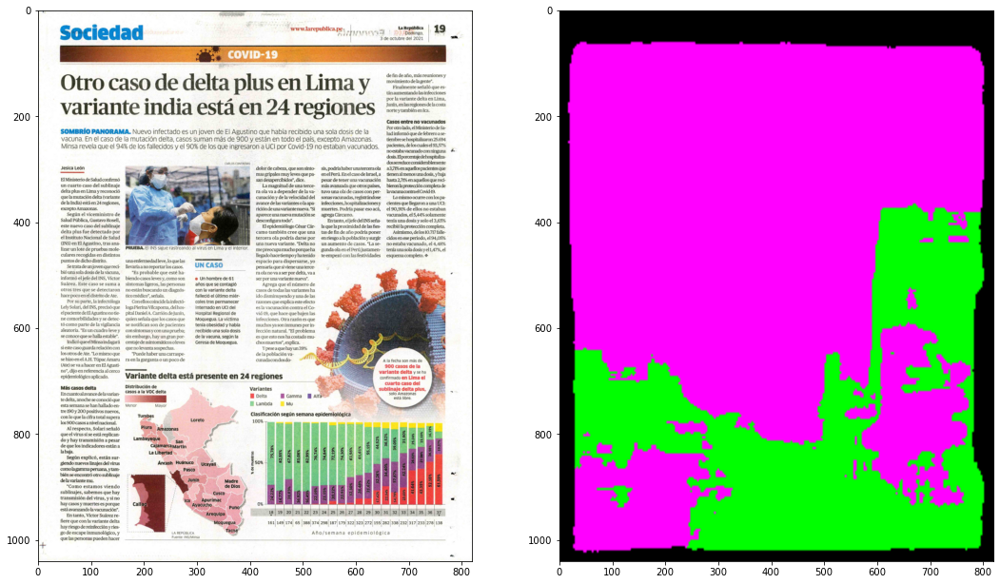

 -background: 17%
 -política: 82%


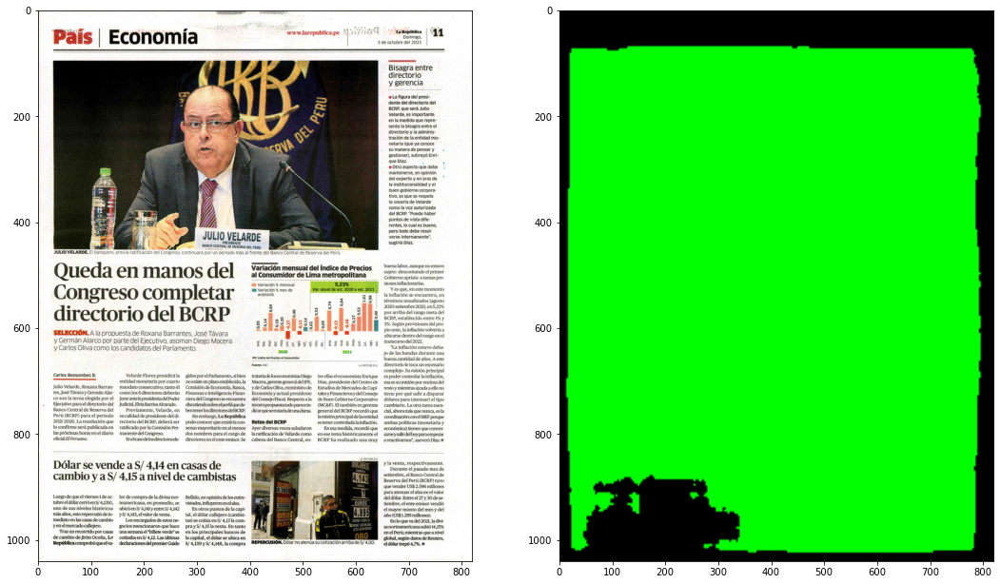

 -background: 22%
 -opinión: 1%
 -política: 37%
 -economía: 23%
 -en portada: 0%
 -ocio y cultura: 0%
 -otros: 14%


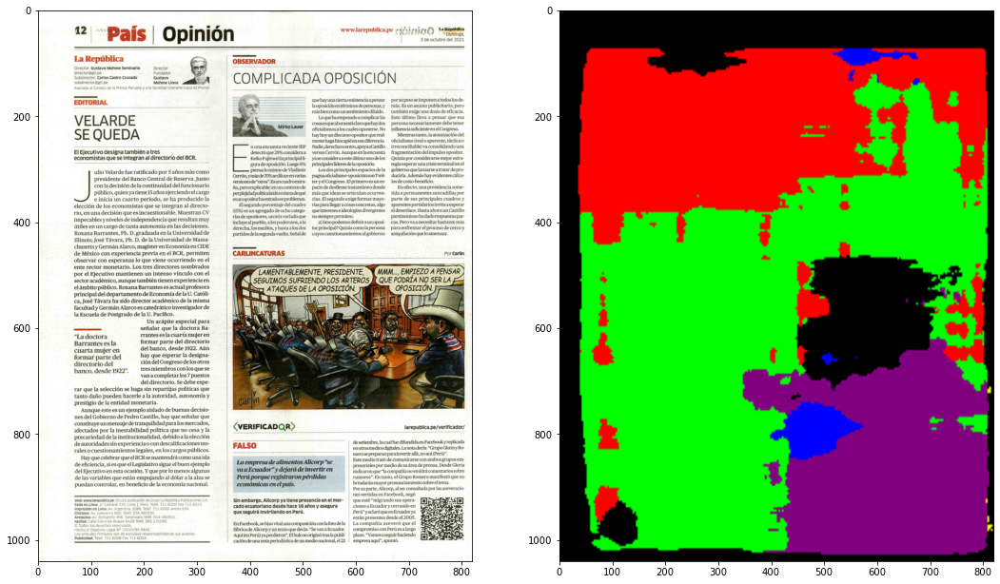

 -background: 13%
 -política: 30%
 -economía: 1%
 -sociedad: 18%
 -en portada: 3%
 -otros: 32%


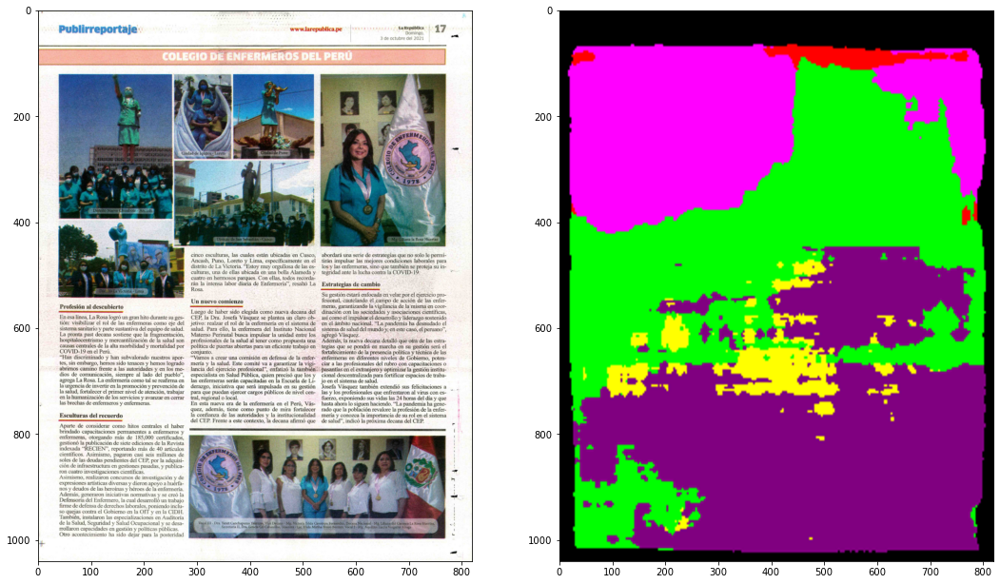

 -background: 13%
 -política: 60%
 -otros: 26%


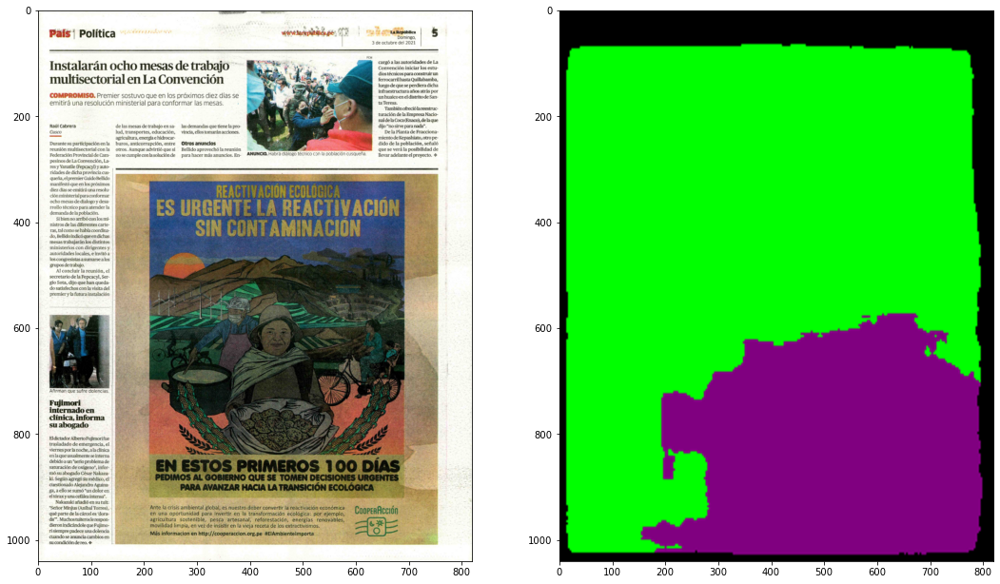

 -background: 15%
 -en portada: 84%


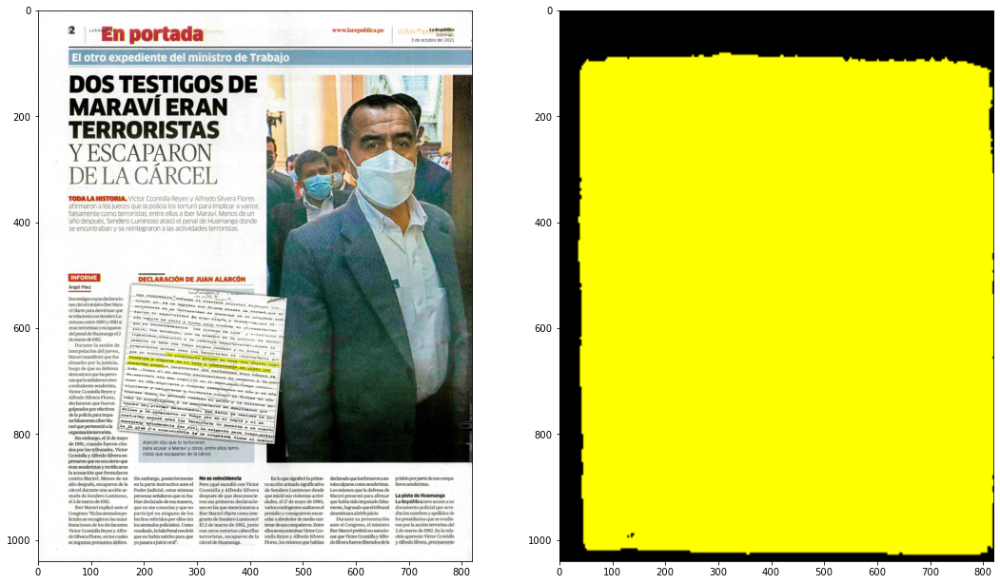

 -background: 14%
 -política: 62%
 -otros: 22%


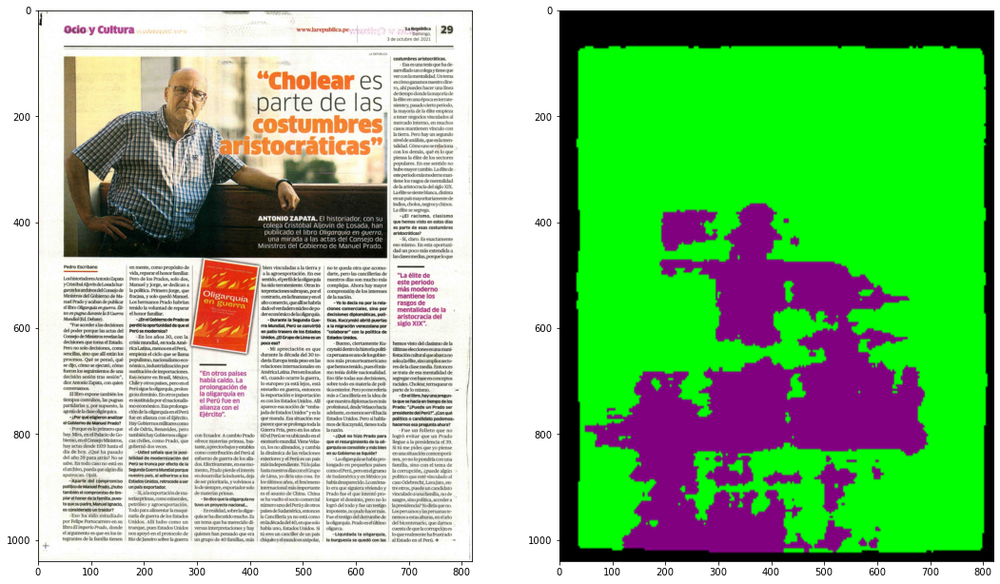

 -background: 14%
 -política: 85%


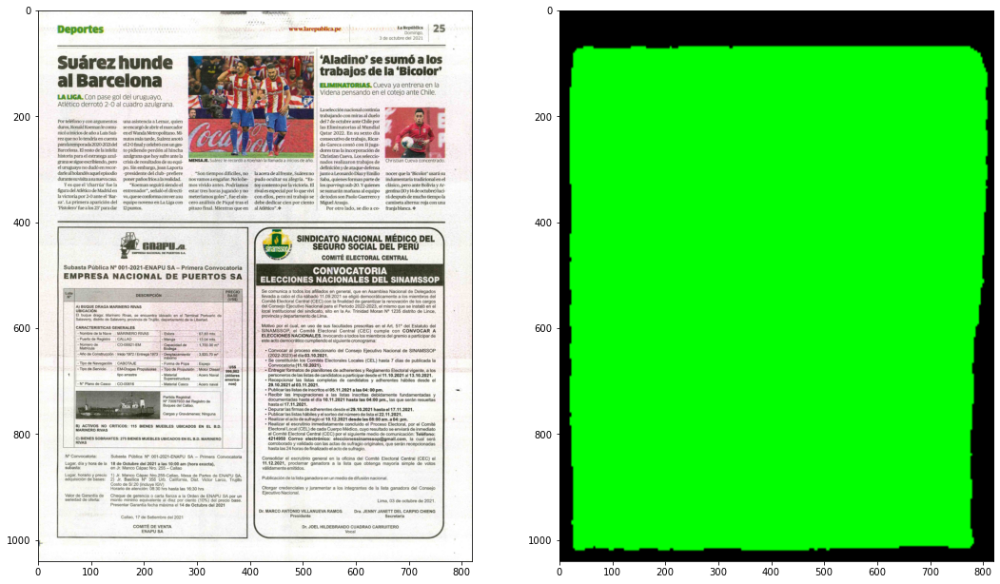

 -background: 14%
 -política: 85%


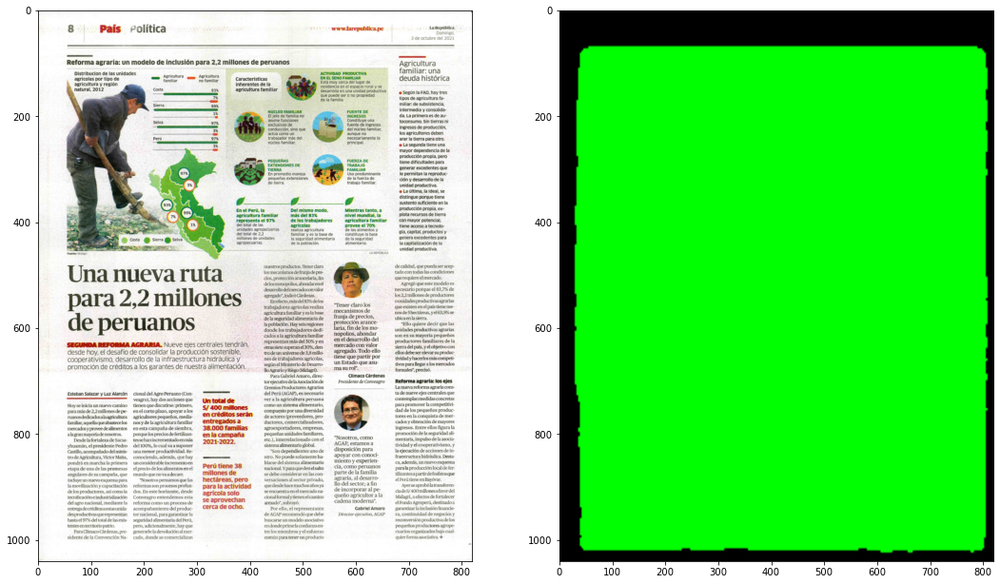

 -background: 13%
 -política: 19%
 -economía: 20%
 -sociedad: 46%


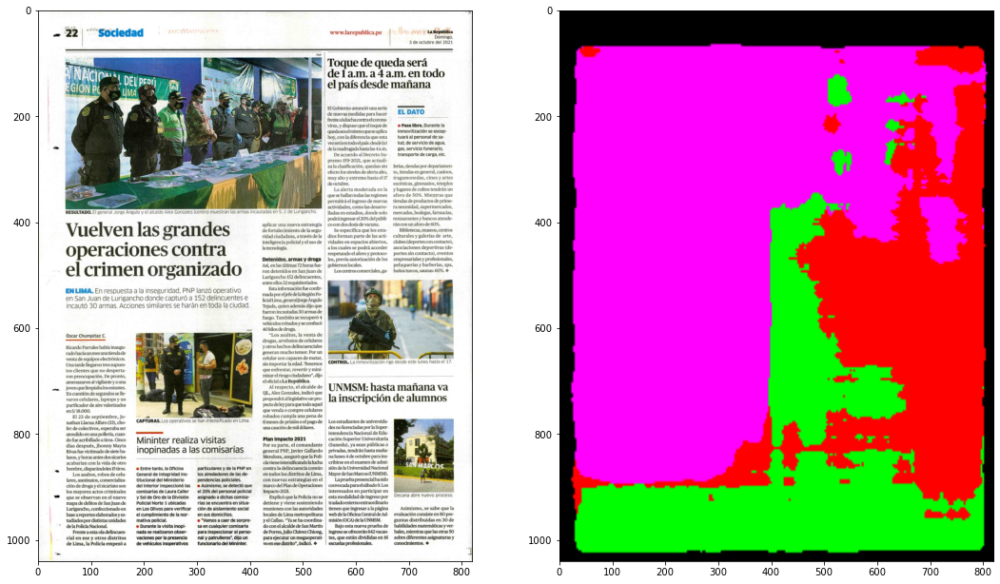

 -background: 5%
 -portada: 94%


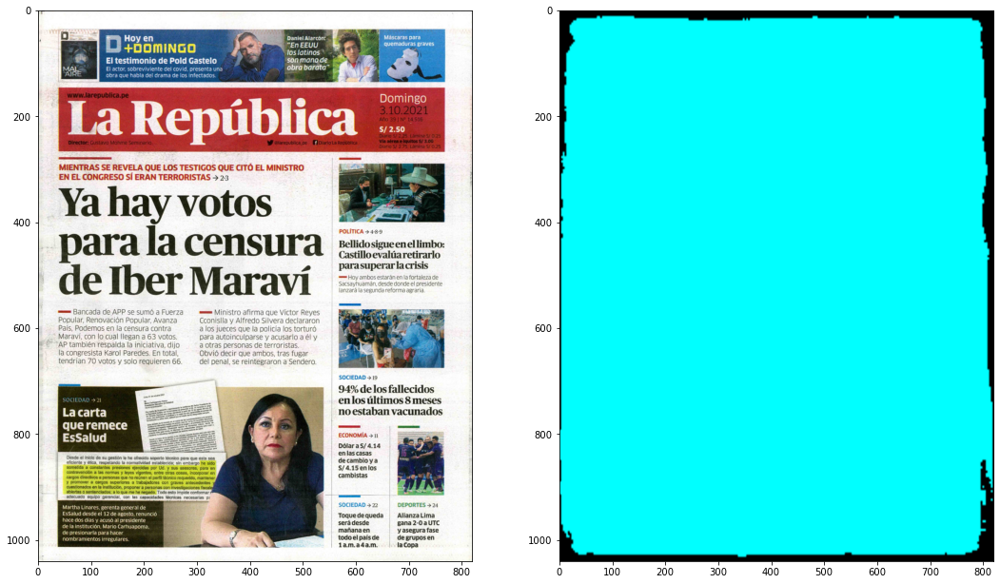

 -background: 10%
 -otros: 89%


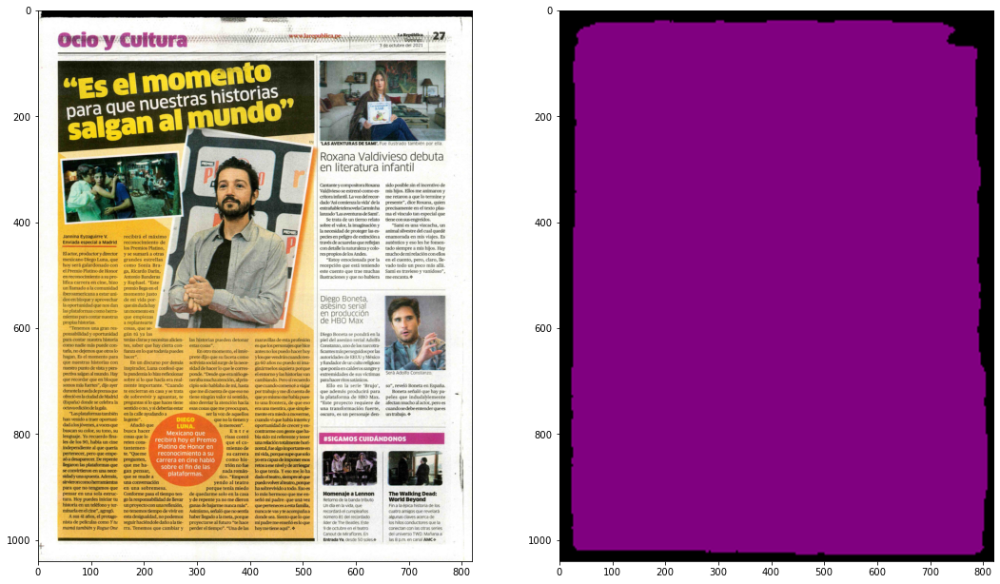

 -background: 13%
 -política: 63%
 -sociedad: 22%


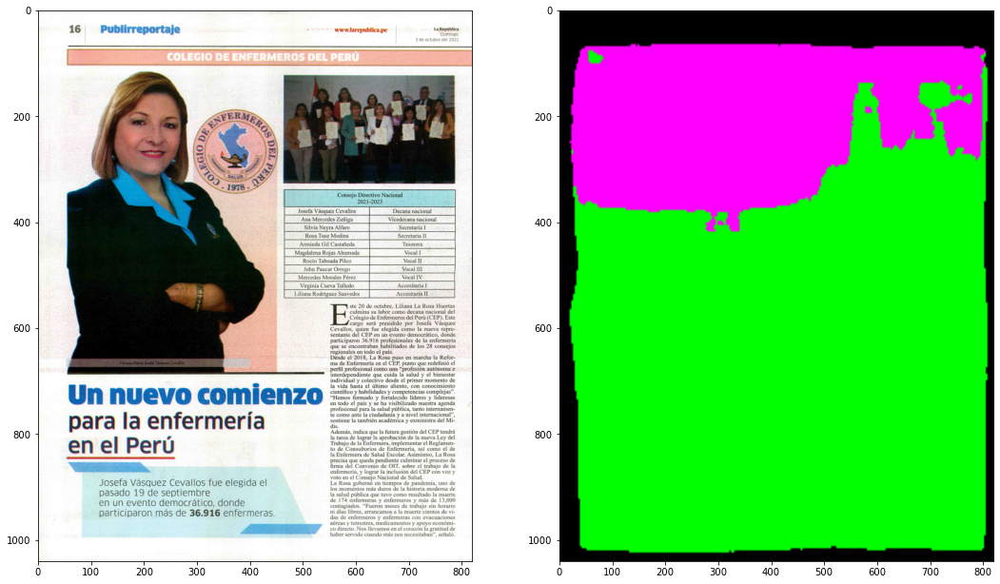

 -background: 13%
 -política: 29%
 -economía: 6%
 -en portada: 2%
 -otros: 48%


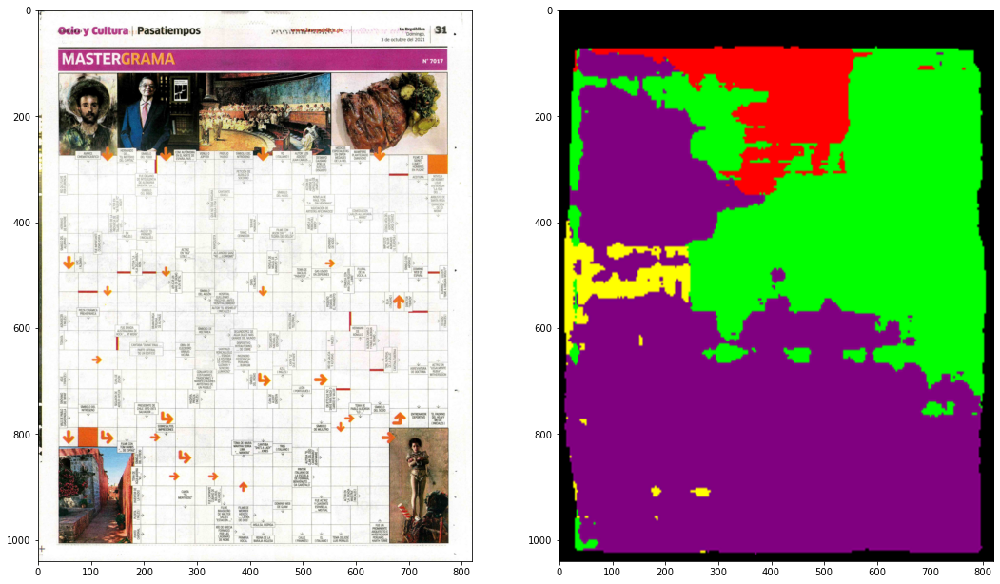

 -background: 22%
 -política: 50%
 -otros: 27%


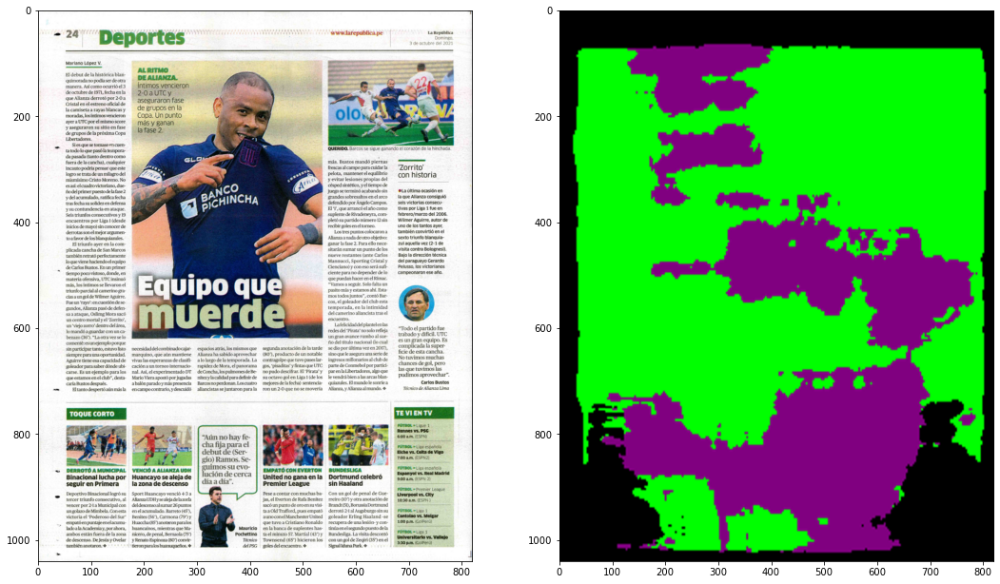

 -background: 10%
 -otros: 89%


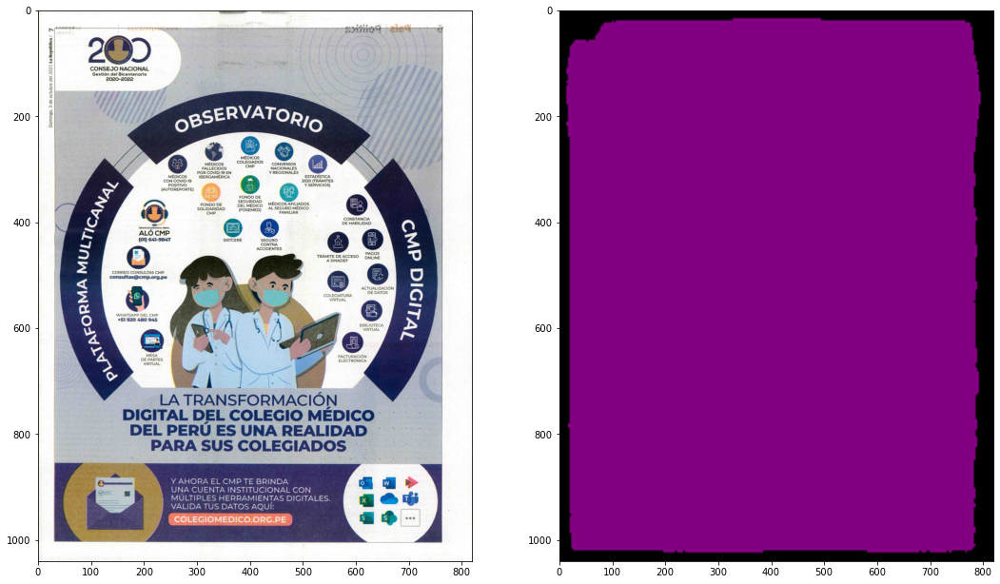

 -background: 14%
 -política: 85%


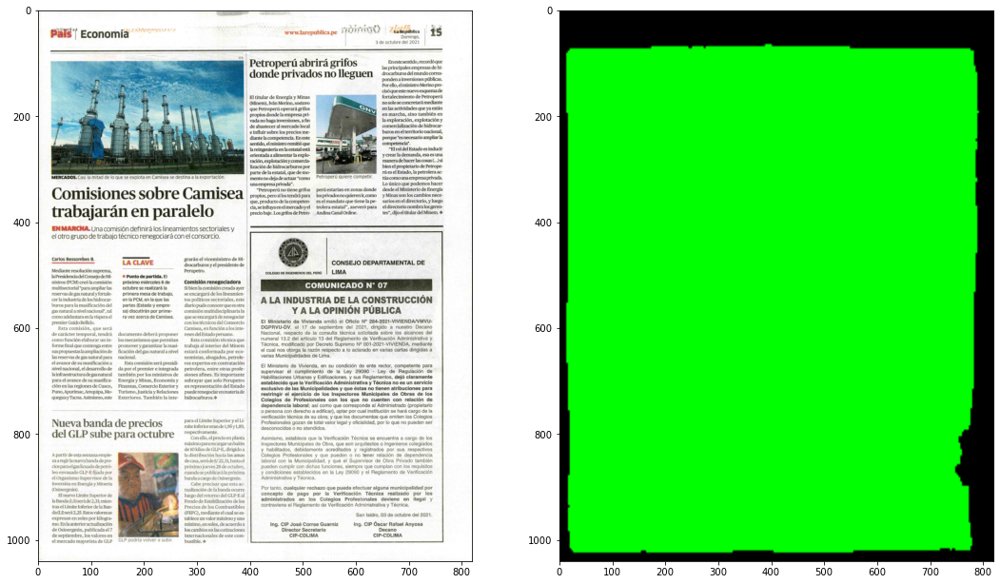

 -background: 10%
 -política: 58%
 -otros: 30%


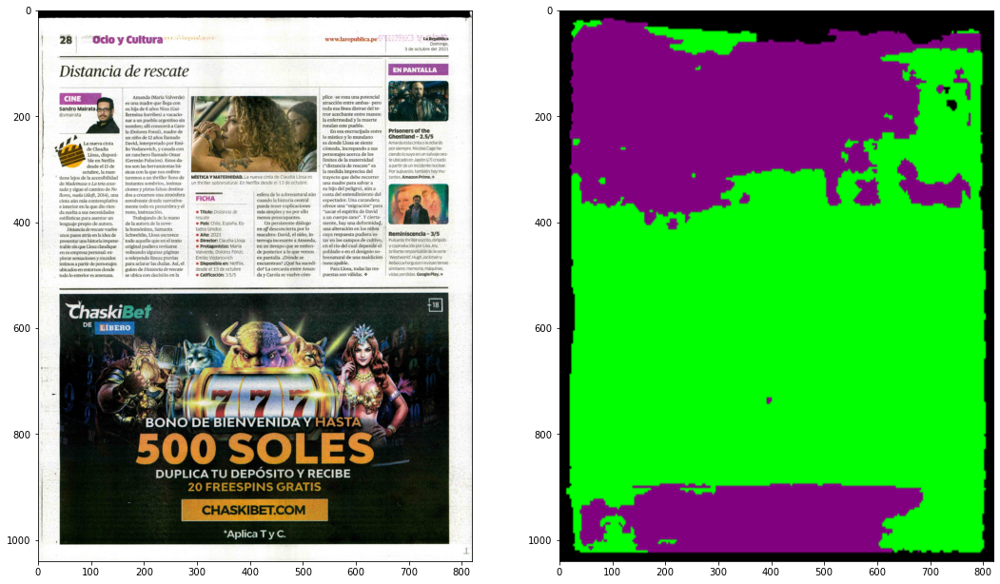

 -background: 13%
 -sociedad: 86%


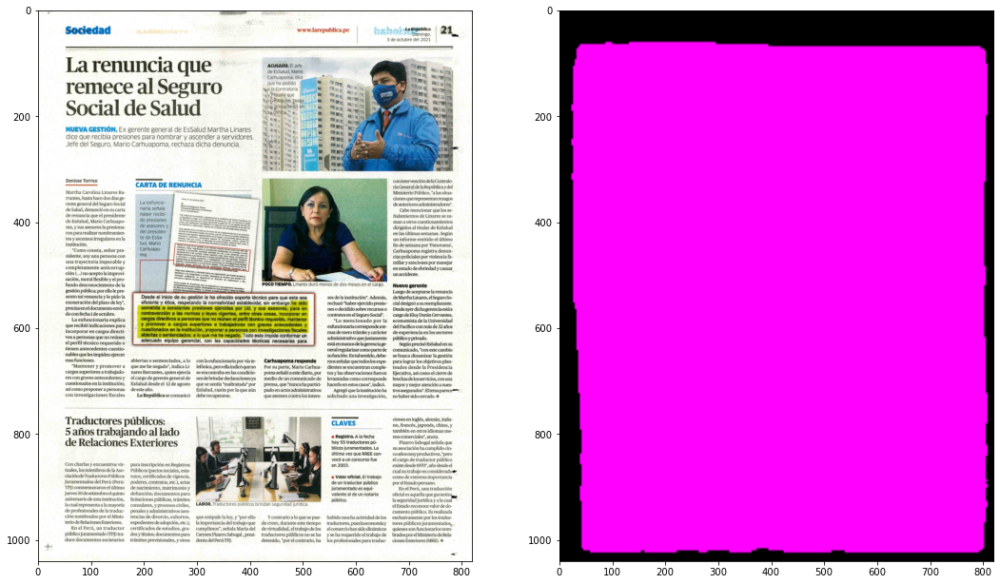

 -background: 15%
 -política: 46%
 -economía: 11%
 -en portada: 0%
 -ocio y cultura: 0%
 -otros: 26%


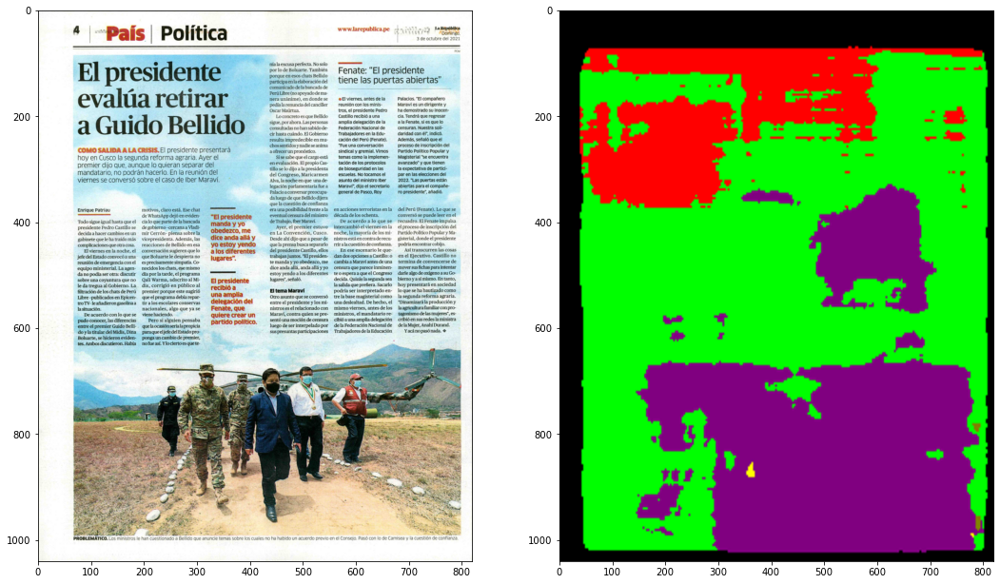

 -background: 12%
 -sociedad: 87%


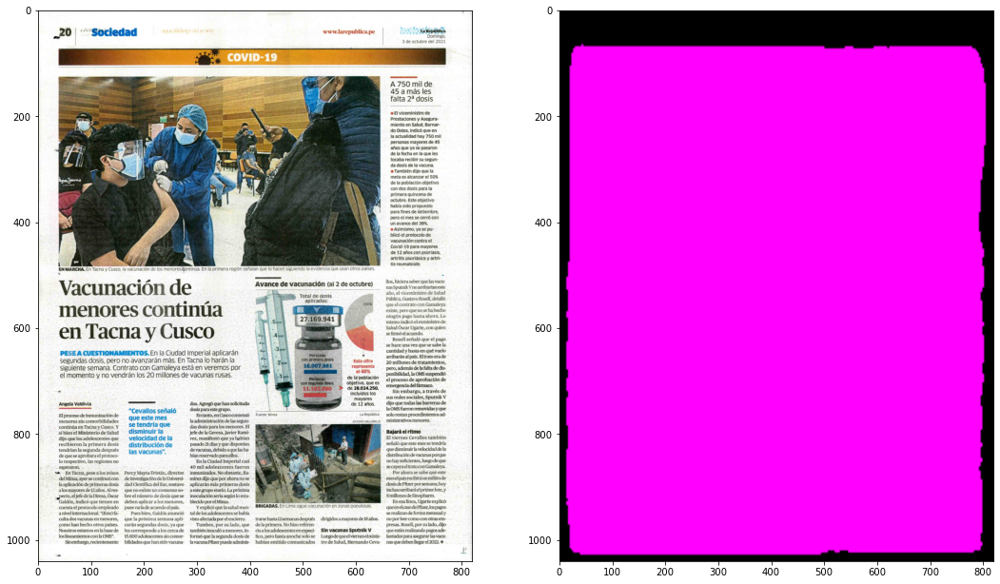

 -background: 14%
 -política: 21%
 -otros: 63%


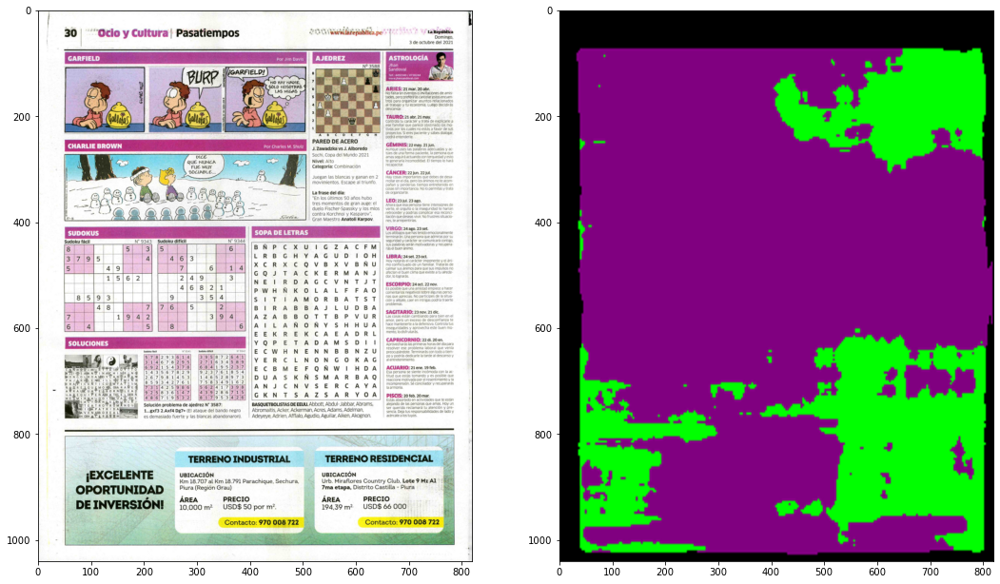

 -background: 11%
 -otros: 88%


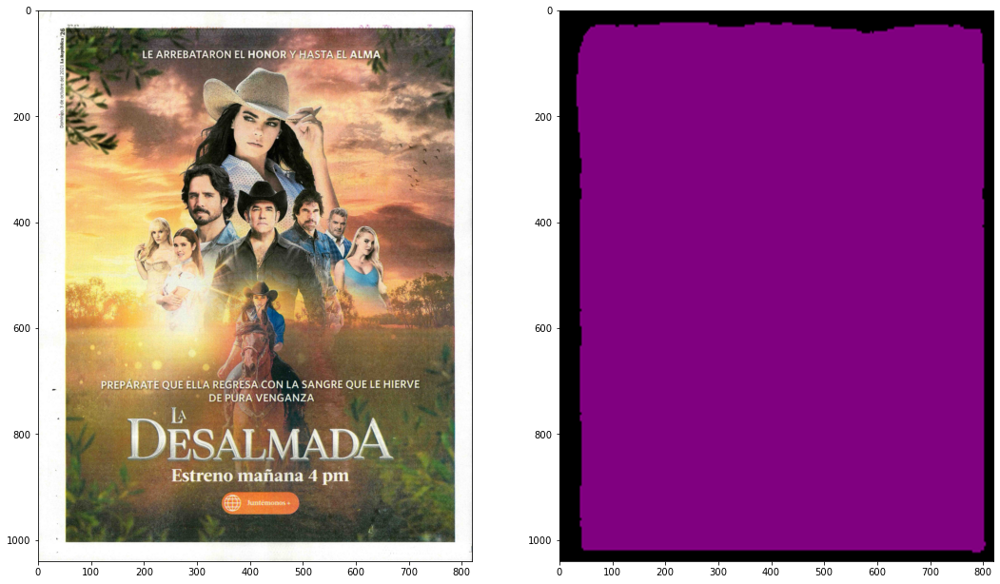

 -background: 14%
 -opinión: 16%
 -política: 42%
 -economía: 11%
 -otros: 14%


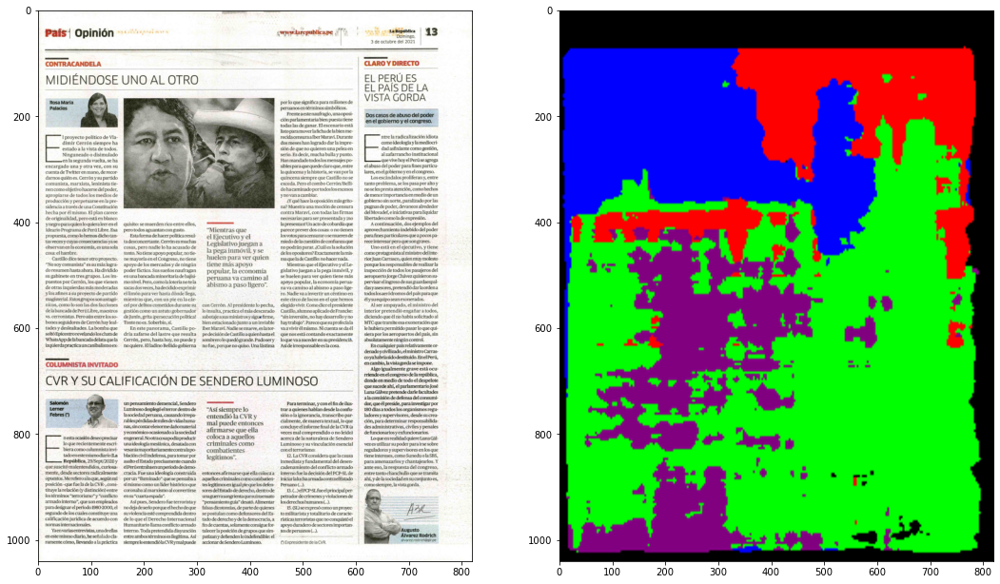

 -background: 14%
 -otros: 85%


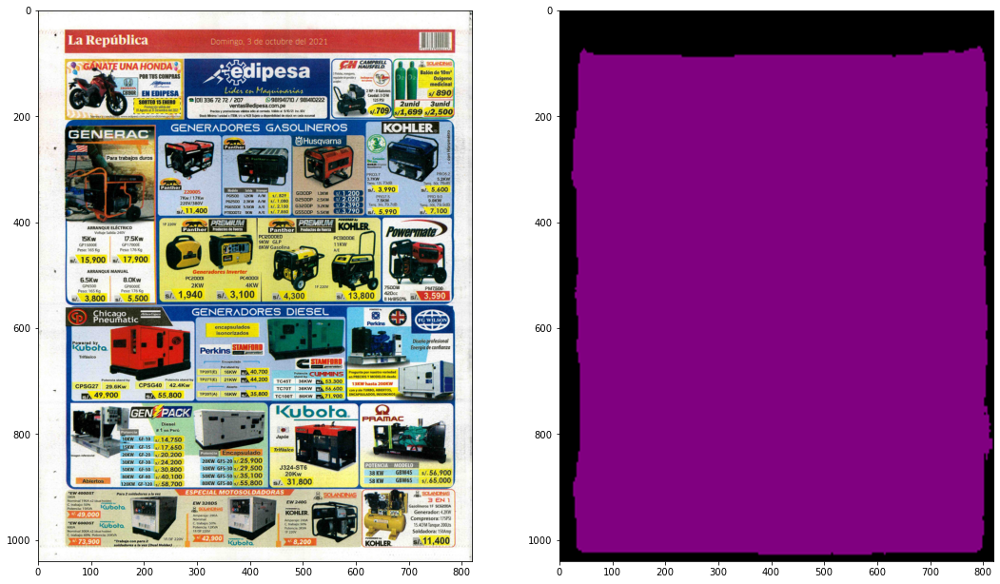

 -background: 14%
 -política: 85%


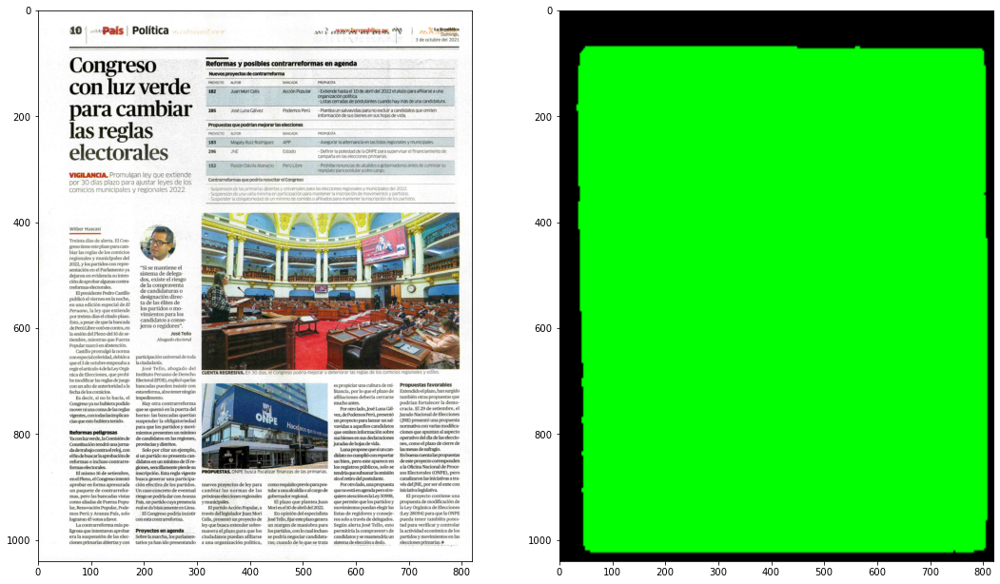

 -background: 15%
 -opinión: 21%
 -política: 15%
 -economía: 12%
 -otros: 34%


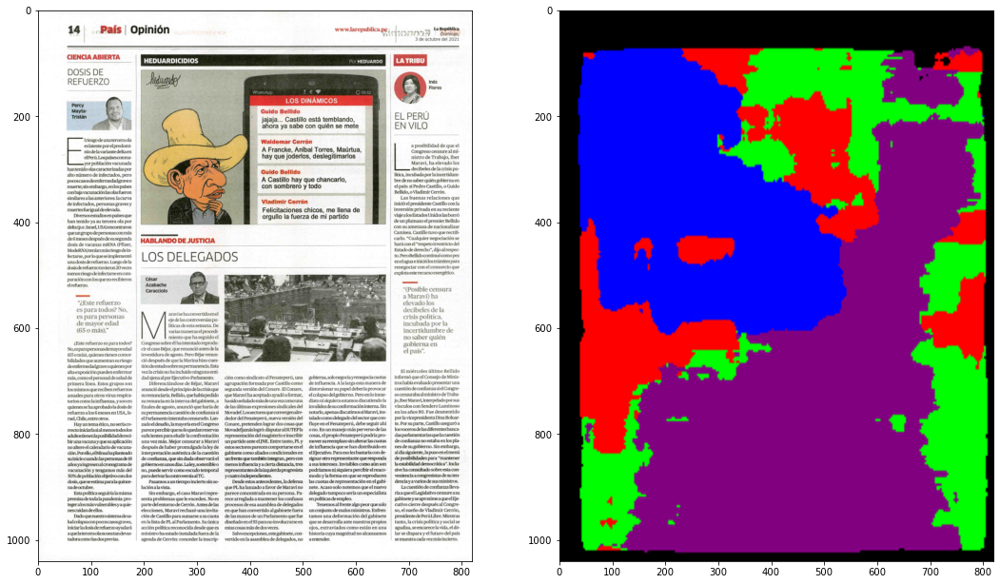

 -background: 16%
 -política: 83%


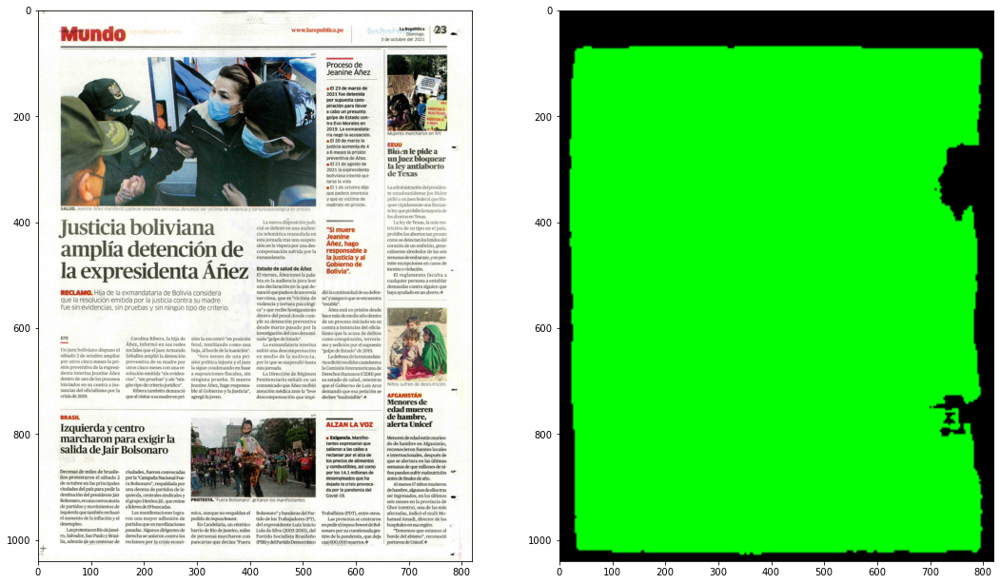

 -background: 23%
 -política: 41%
 -economía: 32%
 -sociedad: 1%
 -otros: 0%


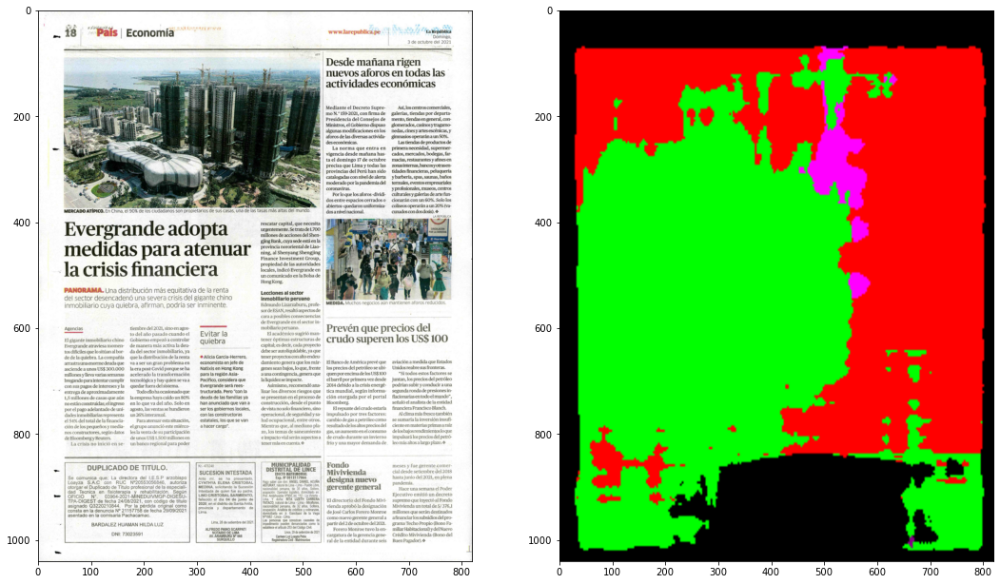

In [25]:
altura_px_ref = 1040
ancho_px_ref = 820

for filename in find_files(directory, '*.jpg'):
    predictions = predict_image(filename, model)
    predictions = predictions.squeeze(0).cpu().numpy()
    predictions = improve_single_prediction(predictions)
    mask = convert_np_to_mask(predictions)
    get_mask_unique_values(predictions)

    # show the mask and the image (resized to 1040x820)
    fig, ax = plt.subplots(1, 2, figsize=(18, 18))
    resized_image = Image.open(filename)
    resized_image = resized_image.resize((ancho_px_ref, altura_px_ref))
    resized_mask = Image.fromarray(mask)
    resized_mask = resized_mask.resize((ancho_px_ref, altura_px_ref))

    ax[0].imshow(resized_image)
    ax[1].imshow(resized_mask)
    plt.show()

In [ ]:
altura_px_ref = 1040
ancho_px_ref = 820

for filename in find_files(directory, '*.jpg'):
    predictions = predict_image(filename, model)
    predictions = predictions.squeeze(0).cpu().numpy()
    predictions = improve_single_prediction(predictions)
    mask = convert_np_to_mask(predictions)
    get_mask_unique_values(predictions)

    # show the mask and the image (resized to 1040x820)
    fig, ax = plt.subplots(1, 2, figsize=(18, 18))
    resized_image = Image.open(filename)
    resized_image = resized_image.resize((ancho_px_ref, altura_px_ref))
    resized_mask = Image.fromarray(mask)
    resized_mask = resized_mask.resize((ancho_px_ref, altura_px_ref))

    ax[0].imshow(resized_image)
    ax[1].imshow(resized_mask)
    plt.show()